In [1]:
import sys
sys.path.insert(0, 'C:/Users/Hank/Downloads/stock_factor_lab_202408/stock_factor_lab')

# 整理暑假的程式
比較新的版本
### 回測期間 - 2009/03/31 ~ 2024目前 (2024/08/31)

## import

In [2]:
from get_data import Data
import backtest
from combinations import sim_conditions
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objects as go
# import plotly.graph_objs as go
import plotly.express as px
from itertools import cycle
from plotly.subplots import make_subplots
from matplotlib import rcParams
rcParams['font.sans-serif'] = ['Microsoft JhengHei']
import matplotlib as mpl
mpl.rcParams['axes.unicode_minus'] = False
from matplotlib.ticker import FuncFormatter
import matplotlib.dates as mdates
from datetime import datetime

# from dataframe import CustomDataFrame

## get data

In [6]:
data=Data()

KeyError: 'database'

---

## 1.畫圖function

### 比較 sim_combinations 多個績效的 CAGR、MDD、**入選股數平均、中位數、25%、75%、最大最小**

In [4]:
def selected_stock_count_analysis(rep_collection_comb):
    results = []
    box_plot_data = []
    
    for key, report in rep_collection_comb.reports.items():
        stock_count = report.stock_data['company_count']
        stock_count_clean = stock_count.dropna()
        
        stats = {
            'Strategy': key,
            'CAGR': report.get_stats()['CAGR'],
            'MDD': report.get_stats()['max_drawdown'],
            '入選股數平均': stock_count_clean.mean(),
            '中位數': stock_count_clean.median(),
            '25%': stock_count_clean.quantile(0.25),
            '75%': stock_count_clean.quantile(0.75),
            'Min': stock_count_clean.min(),
            'Max': stock_count_clean.max()
        }
        
        results.append(stats)
        box_plot_data.append((key, stock_count_clean))
    
    df = pd.DataFrame(results).sort_values('CAGR', ascending=False)
    df.set_index('Strategy', inplace=True)
    
    # # 繪製箱形圖
    # plt.figure(figsize=(15, 10))
    # plt.boxplot([data for _, data in box_plot_data], labels=[key for key, _ in box_plot_data])
    # plt.title('入選股數分佈')
    # plt.ylabel('Stock Count')
    # plt.xlabel('Strategy')
    # plt.xticks(rotation=45, ha='right')
    # plt.tight_layout()
    # plt.show()
    
    return df

### 把多個 report (策略) 的入選公司數量畫成一張折線圖比較

In [5]:
def plot_company_count_comparison(rep_list, label_list, title="公司數量比較"):
    """
    繪製多個報告的公司數量比較圖。

    參數:
    rep_list (list): 包含多個報告對象的列表
    label_list (list): 對應於 rep_list 的標籤列表
    title (str): 圖表標題

    返回:
    None (顯示圖表)
    """
    # 檢查輸入參數
    if len(rep_list) != len(label_list):
        raise ValueError("rep_list 和 label_list 的長度必須相同")

    # 創建 DataFrame
    df = pd.DataFrame()
    for rep, label in zip(rep_list, label_list):
        df[label] = rep.stock_data['company_count']

    # 確保索引是日期類型並排序
    df.index = pd.to_datetime(df.index)
    df = df.sort_index()

    # 繪製折線圖
    plt.figure(figsize=(12, 6))

    # 為每個報告繪製散點圖
    for label in df.columns:
        plt.scatter(df.index, df[label], label=label)

    # 設置圖表標題和軸標籤
    plt.title(title)
    plt.xlabel('年份')
    plt.ylabel('入選股數')

    # 添加圖例
    plt.legend(fontsize=12)    

    plt.gca().xaxis.set_major_locator(mdates.YearLocator())
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y'))

    # 旋轉 x 軸標籤
    # plt.xticks(rotation=90)

    # 自動調整子圖參數，以確保標籤不會被切掉
    plt.tight_layout()

    # 添加網格線
    plt.grid(axis='y', linestyle='--', alpha=0.6)

    # 顯示圖表
    plt.show()

    # # 統計資料
    # print("\nDataFrame info:")
    # print(df.info())

    # print("\nDataFrame description:")
    # print(df.describe())

# 使用示例：
# rep_list = [rep_all_cond, rep_all_cond_and_pe]
# label_list = ['不使用本益比條件進出場', '使用本益比條件進出場']
# plot_company_count_comparison(rep_list, label_list, title='有無本益比條件進出場入選股數比較')

### 每年 TopN (學長的那個 + 股票代號label、print出前幾名 list)

In [6]:
def analyze_top_stocks(rep, topN):
    trades_df = rep.trades
    trades_df["cum_return"] = (1 + trades_df['return']).groupby(trades_df['stock_id']).cumprod() - 1
    trades_df = trades_df.groupby('stock_id').last().reset_index()

    trades_df['entry_date'] = pd.to_datetime(trades_df['entry_date'])
    trades_df['year'] = trades_df['entry_date'].dt.year

    grouped = trades_df.groupby(['year', 'stock_id'])['cum_return'].last().reset_index()

    def process_year_group(group):
        top_stocks = group.nlargest(topN, 'cum_return')
        other_total = group[~group['stock_id'].isin(top_stocks['stock_id'])]['cum_return'].sum()
        other_row = pd.DataFrame({'year': [group['year'].iloc[0]],
                                  'stock_id': ['其他'],
                                  'cum_return': [other_total]})
        return pd.concat([top_stocks, other_row], ignore_index=True)

    final_data = grouped.groupby('year').apply(process_year_group).reset_index(drop=True)

    top_stocks_by_year = {}

    for year in final_data['year'].unique():
        year_data = final_data[final_data['year'] == year]
        top_stocks = year_data[year_data['stock_id'] != '其他']['stock_id'].tolist()
        top_stocks_by_year[year] = top_stocks

    fig = go.Figure()

    other_data = final_data[final_data['stock_id'] == '其他']
    if not other_data.empty:
        fig.add_trace(go.Bar(
            x=other_data['year'],
            y=other_data['cum_return'],
            name='其他',
            marker=dict(
                color='white',
                pattern_shape="/"
            )
        ))

    for stock_id in final_data['stock_id'].unique():
        if stock_id != '其他':
            stock_data = final_data[final_data['stock_id'] == stock_id]
            fig.add_trace(go.Bar(
                x=stock_data['year'],
                y=stock_data['cum_return'],
                name=f'{stock_id}',
                text=stock_id,
                textposition='inside'
            ))

    fig.update_layout(
        barmode='stack',
        title=f'年度前{topN}高報酬所佔全部比例',
        xaxis=dict(title='年份'),
        yaxis=dict(title='累積回報'),
        legend_title="公司代號"
    )

    print(f"每年前 {topN} 高的股票代號：")
    for year, stocks in top_stocks_by_year.items():
        print(f"{year}: {stocks}")

    return fig, top_stocks_by_year, final_data


# # 使用範例
# fig, top_stocks_by_year, final_data = analyze_top_stocks(roe_value_collc_pe_4y15rep, 5)
# fig.show()

### 策略組合的 CAGR 比較值方圖/折線圖

In [7]:
def quantile_CAGR_plot(report_collection, type='plot', title=""):

    # 創建長條圖
    plt.figure(figsize=(10, 6))

    if type=='bar':
        plt.bar(report_collection.stats.T['CAGR'].index, 
                report_collection.stats.T['CAGR'].values)
    else:
        plt.plot(report_collection.stats.T['CAGR'].index, 
                report_collection.stats.T['CAGR'].values)
    # 添加標題和標籤
    plt.title(f'{title}各個分位的CAGR')
    plt.xlabel('Quantiles')
    plt.ylabel('CAGR')

    # 顯示圖表
    plt.grid(axis='y', linestyle='--', alpha=0.4)

    plt.xticks(rotation=45)
    plt.show()

### 數值分佈觀察 (預設是 stacked barplot)

In [8]:
def numeric_bins(df, title, stacked=True, num_label=True,
                bins=[-np.inf, 0, 0.40, 0.80, 1.20, 1.60, 2.00, np.inf], 
                labels=['負值' ,'0-40%', '40-80%', '80-120%', '120-160%', '160-200%', '200%以上']):
    # 對每一列數據進行分類並計算每個區間內的數量
    counts = df.apply(lambda row: 
                      pd.cut(row, bins=bins, labels=labels, right=False).value_counts(), axis=1).fillna(0)
    
    # 將index轉換為年月日
    counts.index = counts.index.strftime('%Y')

    # 繪製長條圖
    ax = counts.plot(kind='bar', stacked=stacked, figsize=(15, 8), width=0.6)

    # # 在長條圖上顯示每個區間的數量和百分比
    # for container in ax.containers:
    #     labels = []
    #     for i, value in enumerate(container.datavalues):
    #         total = sum([c.datavalues[i] for c in ax.containers])
    #         percent = f'{value/total:.1%}' if total > 0 else '0%'
    #         labels.append(f'{value} \n ({percent})')
    #     ax.bar_label(container, labels=labels, label_type='center')

    if stacked==True and num_label==True:
        # 在長條圖上顯示每個區間的數量
        for container in ax.containers:
            # 設置標籤
            ax.bar_label(container, label_type='center')

    # grid
    ax.grid(axis='y', linestyle='--', alpha=0.6)
    ax.grid(axis='x', linestyle='--', alpha=0.6)

    plt.xlabel('年份')
    plt.ylabel('數量')
    plt.title(f'{title} 每年數值區間分佈')
    plt.legend(title='區間', loc='upper left', bbox_to_anchor=(1, 1))
    plt.show()

### ROE 參數最佳化 CAGR 比較 (3、4、5年 ROE > N %)

In [9]:
def plot_roe_cagr(roe_value_collection, plot_line_chart=True, title="plot"):
    roe_reports = roe_value_collection.reports

    # 定義不同組別的鍵
    groups = ['3y', '4y', '5y']
    thresholds = ['10', '15', '20', '25']

    # 初始化存儲CAGR數據和公司數量的字典
    cagr_data = {group: [] for group in groups}
    company_counts = {threshold: {group: 0 for group in groups} for threshold in thresholds}

    # 提取CAGR數據和公司數量
    for group in groups:
        for threshold in thresholds:
            key = f'roe_{group}_{threshold}'
            cagr = roe_reports[key].get_stats()['CAGR']
            cagr_data[group].append(cagr)
            
            # 獲取公司數量
            company_count = round(roe_reports[key].stock_data[roe_reports[key].stock_data['company_count'].notna()]['company_count'].mean(), 1)
            company_counts[threshold][group] = company_count

    # 繪製條形圖和折線圖
    fig, ax1 = plt.subplots(figsize=(28, 14))  # 增加図表大小

    # 設置條形圖的位置
    bar_width = 0.2
    index = np.arange(len(thresholds))

    colors = ['tab:orange', 'tab:blue', 'tab:red']

    # 繪製每組的CAGR值
    for i, (group, color) in enumerate(zip(groups, colors)):
        ax1.bar(index + i * bar_width, cagr_data[group], bar_width, color=color, label=f'ROE {group.strip("y")} 年平均', alpha=0.8)

    # 設置左側y軸（CAGR）
    ax1.set_ylabel('CAGR', fontsize=22)
    ax1.set_title(title, fontsize=25)
    ax1.set_xticks(index + bar_width)
    ax1.set_xticklabels([f'ROE > {t}%' for t in thresholds], fontsize=20)
    ax1.tick_params(axis='y', labelsize=20, labelcolor='tab:blue')

    # 創建右側y軸（公司數量）
    ax2 = ax1.twinx()

    if plot_line_chart:
        # 計算y軸的偏移量
        max_cagr = max(max(cagr_data[group]) for group in groups)
        y_offset = max_cagr * 0.1  # 使用CAGR最大值的10%作為偏移量

        # 為每個閾值繪製公司數量的折線圖
        colors = ['red', 'green', 'blue', 'purple']
        for i, threshold in enumerate(thresholds):
            counts = [company_counts[threshold][group] for group in groups]
            x_positions = index[i] + np.arange(len(groups)) * bar_width
            
            # 將折線圖的y值加上偏移量
            adjusted_counts = [count + y_offset for count in counts]
            
            ax2.plot(x_positions, adjusted_counts, color=colors[i], marker='o', linestyle='-', linewidth=2, markersize=8, 
                     label=f'ROE > {threshold}% 平均入選公司數')

            # 在每個數據點上添加標籤
            for j, count in enumerate(counts):
                ax2.annotate(str(count), (x_positions[j], adjusted_counts[j]), textcoords="offset points", xytext=(0, 10), 
                             ha='center', fontsize=15)

        ax2.set_ylabel('平均入選公司數量', fontsize=22, rotation=270, labelpad=30)
        ax2.tick_params(axis='y', labelsize=18, labelcolor='tab:orange')

        # 調整y軸範圍以顯示偏移後的折線圖
        ax2.set_ylim(0, 750)

    # 增大legend的字體大小並放置在图表外部
    ax1.legend(loc='upper left', bbox_to_anchor=(1.02, 1), fontsize=20)
    if plot_line_chart:
        ax2.legend(loc='upper left', bbox_to_anchor=(1.02, 0.9), fontsize=20)

    # 調整布局以防止重疊並增加空白區域
    plt.tight_layout()
    plt.subplots_adjust(right=0.85)  # 增加右邊空白區域放legend

    # 顯示圖表
    plt.show()

### 入選公司數量

In [10]:
def plot_company_counts(rep):
    stock_data_orig = rep.stock_data
    stock_data_orig[stock_data_orig['company_count'].notna()]
    # stock_data_orig = stock_data_orig.resample('M').last()

    plt.figure(figsize=(12, 8))
    plt.plot(stock_data_orig.index, stock_data_orig['company_count'], marker='o', linestyle='-', linewidth=1)
    plt.title('入選股數量走勢圖', fontsize=14)
    plt.xlabel('時間(年)', fontsize=12)
    plt.ylabel('入選股數量', fontsize=12)
    
    # 顯示所有年份
    plt.gca().xaxis.set_major_locator(mdates.YearLocator())
    # plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
    
    plt.xticks(rotation=90, ha='center', fontsize=10)
    plt.yticks(fontsize=12)
    plt.grid(True)
    plt.show()

### 比較 ROE 參數最佳化策略中有無加上本益比進出場的 CAGR

In [11]:
def plot_roe_cagr_w_pe(collection):
    years = [3, 4, 5]
    roe_percentages = [10, 15, 20, 25]
    
    strategies = [f'{year}y平均>{roe}%' for year in years for roe in roe_percentages]
    n_strategies = len(strategies)
    
    cagr_without_pe = []
    cagr_with_pe = []
    
    for year in years:
        for roe in roe_percentages:
            cagr_without_pe.append(collection.reports[f'roe_{year}y_{roe}'].get_stats()['CAGR'])
            cagr_with_pe.append(collection.reports[f'roe_{year}y_{roe}_pe'].get_stats()['CAGR'])
    
    x = np.arange(n_strategies)
    width = 0.35
    
    fig, ax = plt.subplots(figsize=(18, 8))
    rects1 = ax.bar(x - width/2, cagr_without_pe, width, label='無進出場條件')
    rects2 = ax.bar(x + width/2, cagr_with_pe, width, label='有本益比當進場條件')
    
    ax.set_ylabel('CAGR')
    ax.set_title('ROE + 其他條件固定 + 有無進出場條件比較')
    ax.set_xticks(x)
    ax.set_xticklabels(strategies, rotation=90, ha='right', fontsize=14)
    ax.legend(fontsize=18)
       
    fig.tight_layout()
    plt.grid(axis='y', linestyle='--', alpha=0.6)
    plt.show()

---

## 2.資料下載

##### memo: 目前資料庫裡的資料都是從 `IFRS以合併為主簡報(累計)`來的 (本來是單季)，因為有的資料累計才有 2005 以前。長期投資、固定資產等存量資料不影響，但 ROE、稅後淨利等就會有影響，現在都是取 3/31 當年資料。

### **盈餘再投資率**

In [12]:
profit = data.get('report_fundamentals:常續性稅後淨利')

In [13]:
# 每年淨利
adj_profit = profit.resample('A-MAR').last()[:'2024-03-31']

In [14]:
# 抓資料
long_term_items = [
    '透過損益按公允價值衡量之金融資產－非流動',
    '透過其他綜合損益按公允價值衡量之金融資產－非流動',
    '按攤銷後成本衡量之金融資產－非流動',
    '避險之金融資產－非流動',
    '合約資產－非流動',
    '採權益法之長期股權投資',
    '預付投資款',
    '投資性不動產淨額'
]

# 長期投資項目 (8個)
long_term_data = [data.get(f'report_fundamentals:{item}').fillna(0) for item in long_term_items]

# 固定資產和淨利
fixed_assets = data.get('report_fundamentals:不動產廠房及設備').fillna(0)

In [15]:
# 轉換為年度資料
def to_yearly(df):
    return df.resample('A-MAR').last().astype('int64')[:'2024-03-31']

long_term_years = [to_yearly(df) for df in long_term_data]

# 長期投資項目 (8個) 加總
long_term_investment = sum(long_term_years)
fixed_assets_year = to_yearly(fixed_assets)

In [16]:
# 計算盈再率分子
long_term_investment_df = (long_term_investment - long_term_investment.shift(4))['2005-03-31':].astype('int64')
fixed_assets_df = (fixed_assets_year - fixed_assets_year.shift(4))['2005-03-31':].astype('int64')

# long_term_investment_df = long_term_investment.diff(4)['2005-03-31':].astype('int64')
# fixed_assets_df = fixed_assets_year.diff(4)['2005-03-31':].astype('int64')


In [17]:
profit_rol_df = adj_profit.rolling(4).sum()['2005-03-31':]

In [18]:
# 計算出盈再率
# 去掉淨利為負的公司 (當年度淨利為負、四年加總淨利為負都去掉)
rr = (long_term_investment_df + fixed_assets_df) / profit_rol_df
rr = rr[(adj_profit > 0) & (profit_rol_df > 0)]

In [19]:
rr

company_symbol,1101,1102,1103,1104,1108,1109,1110,1201,1203,1210,...,9944,9945,9946,9949,9950,9951,9955,9958,9960,9962
2005-03-31,1.061549,2.070673,0.552180,5.151004,NaN,-0.770317,1.100864,NaN,20.779871,-0.010606,...,0.648532,NaN,-0.027250,-0.044297,-0.386520,0.403769,0.370980,0.936592,0.105303,-0.190615
2006-03-31,-1.086303,1.208228,1.122982,0.273796,NaN,-0.625743,-0.278697,-0.515753,4.146777,-0.429598,...,0.369066,NaN,0.717121,-0.036121,-0.308903,0.378146,0.401738,0.388133,0.099235,-0.174807
2007-03-31,-0.883051,1.248040,1.246196,0.392781,-0.675487,-0.671147,0.026735,-0.656122,NaN,0.121807,...,0.105770,0.106287,0.812467,0.321042,-0.176948,0.395273,0.437476,0.346243,0.044025,0.188450
2008-03-31,0.048060,1.123987,-1.128753,0.612144,NaN,-0.768714,0.003459,-0.151802,26.650963,0.433498,...,0.322460,-0.173880,NaN,0.480371,0.063117,0.467598,0.317613,0.982885,0.007702,0.225849
2009-03-31,0.532574,1.201192,-0.948628,NaN,NaN,-0.367524,-0.806167,0.199409,-0.671419,0.899770,...,0.760227,-0.851608,NaN,0.742063,0.543723,NaN,0.228987,1.522176,-0.018206,NaN
2010-03-31,0.759126,1.630827,NaN,2.276644,8.416042,-0.367608,-1.116186,0.365797,-0.136624,0.781360,...,0.321297,0.426502,NaN,0.957466,0.451218,0.495577,0.292466,1.679322,-0.046945,NaN
2011-03-31,1.059155,1.448166,-0.927129,-0.434489,NaN,NaN,-1.304369,0.742575,0.150105,0.705058,...,0.899880,1.150649,-0.612001,0.698636,0.271182,0.123573,0.115286,3.864021,-0.031433,NaN
2012-03-31,0.882052,1.095566,0.528983,-0.161369,NaN,10.332942,-1.208647,1.387184,-0.263823,0.706491,...,0.604668,3.650112,-0.045970,0.700202,0.209280,0.368914,0.383648,NaN,-0.002011,NaN
2013-03-31,-0.093182,1.916927,-2.203723,0.223181,NaN,18.613283,1.227611,2.470831,0.475643,0.583500,...,1.104347,3.023909,-0.001427,0.135986,0.728800,0.209878,0.853237,1.558037,0.002019,NaN
2014-03-31,-0.234579,1.580163,0.283474,0.399968,NaN,8.763699,1.040889,2.568347,0.722349,0.854814,...,1.720730,1.145966,-0.002264,-0.292461,1.427051,0.476986,NaN,1.480800,0.020332,-0.402781


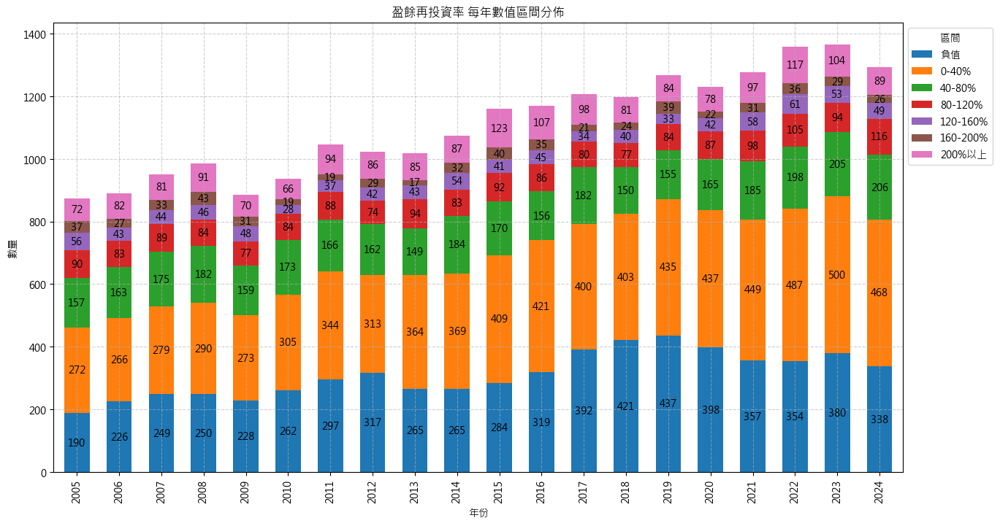

In [20]:
numeric_bins(rr, "盈餘再投資率")

---

### **本益比 (P/E)**
- 每季資料
- 每日資料

In [21]:
pe = data.get('report_fundamentals:本益比-TSE')
daily_pe = data.get('price:daily_pe')

### **其他因子**

- ROE (季資料，取第四季)
- 股利支付率 (只有年資料) ＝〈現金股利總額〈元〉／ 股利分配年度之稅後淨利〉x 100
- 董監持股 (沒有每年的資料，缺值採向前補值)
- 上市上櫃滿兩年

In [22]:
roe = data.get('report_fundamentals:ROE(A)－稅後').resample('A-MAR').last()[:'2024-03-31']
payout_ratio = data.get('report_fundamentals:股利支付率')

In [23]:
roe

company_symbol,1101,1102,1103,1104,1108,1109,1110,1201,1203,1210,...,9944,9945,9946,9949,9950,9951,9955,9958,9960,9962
2001-03-31,3.15,0.47,-4.53,1.23,-9.58,2.93,-3.63,-0.05,-17.04,10.07,...,22.07,-10.32,9.31,19.84,-3.68,13.49,35.66,9.52,NaN,4.12
2002-03-31,0.70,0.81,0.66,-2.59,-6.38,0.47,-1.40,-10.93,-10.62,7.60,...,12.07,2.62,7.78,20.57,5.35,13.46,7.35,-13.24,-45.63,0.12
2003-03-31,3.39,3.53,4.71,1.16,1.71,7.39,4.44,1.68,1.89,3.64,...,12.23,-0.13,7.97,3.07,5.35,13.38,19.68,-8.64,35.98,14.93
2004-03-31,4.02,8.53,6.67,7.33,1.99,3.54,4.41,2.05,5.01,5.01,...,12.71,-0.05,9.82,8.20,5.08,37.81,16.54,6.74,33.20,15.45
2005-03-31,9.19,14.62,4.81,7.58,4.08,5.18,3.17,-26.95,6.79,2.12,...,9.41,2.99,13.37,17.63,7.72,34.55,17.92,24.77,26.51,24.98
2006-03-31,11.58,13.33,2.23,2.45,4.93,6.04,3.36,8.43,-3.05,13.50,...,11.60,4.38,0.04,19.46,8.07,17.92,16.93,19.47,13.86,5.88
2007-03-31,11.97,12.32,20.28,3.81,6.00,6.83,0.84,11.21,-3.80,15.13,...,14.21,16.48,2.25,16.91,3.03,24.02,15.25,16.30,15.28,34.10
2008-03-31,12.37,14.60,6.34,3.63,2.89,4.06,3.23,9.88,0.17,16.39,...,48.57,11.45,-10.13,13.34,5.85,24.73,16.95,10.41,18.95,5.02
2009-03-31,6.70,9.74,1.34,0.43,-0.84,2.76,0.09,10.71,15.77,9.66,...,3.56,7.92,-9.66,2.91,4.01,-49.03,9.68,2.02,11.89,-42.03
2010-03-31,12.23,10.84,2.13,5.55,2.30,1.74,1.11,12.38,13.09,11.15,...,6.62,6.16,3.34,6.19,11.14,25.75,10.44,3.59,17.91,8.42


In [24]:
payout_ratio

company_symbol,1101,1102,1103,1104,1108,1109,1110,1201,1203,1210,...,9944,9945,9946,9949,9950,9951,9955,9958,9960,9962
2001-03-31,0.00,289.91,0.00,65.64,0.00,78.31,0.00,0.00,0.00,38.73,...,6.15,0.00,77.72,0.00,0.00,0.00,36.88,0.00,0.00,104.29
2002-03-31,0.00,135.02,0.00,0.00,0.00,137.00,0.00,0.00,0.00,94.40,...,30.07,0.00,58.54,0.00,25.41,0.00,0.00,0.00,0.00,0.00
2003-03-31,86.92,87.86,0.00,0.00,63.35,50.41,83.85,0.00,0.00,77.95,...,37.64,0.00,59.21,72.84,98.07,0.00,0.00,0.00,0.00,85.07
2004-03-31,50.58,39.90,0.00,0.00,73.16,61.24,0.00,0.00,0.00,29.39,...,30.36,0.00,56.88,20.16,86.26,40.93,0.00,0.00,0.00,0.00
2005-03-31,41.89,40.47,0.00,0.00,68.61,76.64,83.88,0.00,0.00,100.38,...,41.49,0.00,59.95,23.39,76.16,30.85,0.00,51.66,0.00,0.00
2006-03-31,74.38,42.50,0.00,0.00,82.33,62.33,99.03,0.00,0.00,71.86,...,25.91,202.40,0.00,32.46,78.22,45.50,0.00,30.98,9.73,80.81
2007-03-31,79.28,52.70,0.00,0.00,67.17,40.07,254.94,0.00,0.00,48.98,...,28.38,91.45,0.00,27.49,79.90,70.44,29.51,23.71,0.00,84.75
2008-03-31,74.77,64.98,0.00,0.00,79.51,85.95,85.79,0.00,0.00,58.39,...,35.70,84.96,0.00,35.38,81.92,40.45,50.91,17.15,0.00,86.23
2009-03-31,75.43,71.33,0.00,0.00,0.00,44.57,0.00,0.00,15.59,60.38,...,23.31,47.51,0.00,95.22,89.99,0.00,69.29,0.00,39.04,0.00
2010-03-31,79.82,68.16,34.71,43.56,65.37,136.47,126.46,44.34,28.13,49.39,...,12.47,140.74,0.00,89.53,89.85,13.97,94.37,24.20,0.00,0.00


In [25]:
stock_hold = data.get('report_fundamentals:董監持股%')
stock_hold
# stock_hold = stock_hold.resample('A-MAR').ffill()

company_symbol,1101,1102,1103,1104,1108,1109,1110,1201,1203,1210,...,9944,9945,9946,9949,9950,9951,9955,9958,9960,9962
2001-03-31,7.11,31.82,6.05,9.77,32.02,60.52,13.63,6.70,17.47,11.84,...,30.96,37.64,30.59,25.37,37.82,58.89,78.52,34.36,NaN,58.02
2002-03-31,5.84,31.85,12.27,10.53,18.68,60.86,12.96,7.77,17.71,11.86,...,34.34,37.64,31.82,24.95,49.55,56.73,64.92,42.26,34.61,58.02
2003-03-31,7.03,33.02,26.64,11.29,18.69,60.85,12.82,7.69,16.97,13.32,...,34.34,37.64,32.03,24.95,46.77,47.23,62.94,40.11,35.68,44.62
2004-03-31,7.92,33.02,26.39,11.25,18.69,62.33,26.00,10.97,16.97,13.08,...,32.36,37.64,28.38,22.55,46.77,34.57,54.81,40.12,42.21,34.79
2005-03-31,7.67,33.06,25.75,11.25,14.29,54.29,26.16,12.09,16.15,13.12,...,30.91,37.64,20.80,22.39,41.38,34.51,53.20,31.57,28.93,25.93
2006-03-31,10.06,31.88,25.99,11.77,14.29,52.82,25.42,12.15,16.15,13.12,...,21.94,37.67,18.95,20.61,41.38,34.06,32.63,28.46,28.53,18.86
2007-03-31,10.53,31.88,24.56,12.85,14.29,53.23,25.89,12.07,21.20,13.12,...,21.23,34.89,19.23,19.99,41.38,18.69,30.15,19.83,28.48,23.94
2008-03-31,10.33,31.88,24.56,12.93,15.47,53.15,25.85,12.08,21.45,15.77,...,21.99,28.74,19.24,19.08,41.38,14.48,23.61,19.92,26.81,21.17
2009-03-31,11.46,31.76,25.26,24.39,15.42,53.22,28.71,12.08,21.45,15.30,...,20.98,28.71,35.78,18.27,41.38,22.37,23.25,18.03,26.45,20.97
2010-03-31,11.97,30.10,25.53,34.19,15.42,31.89,29.05,12.40,21.11,15.46,...,20.98,28.71,57.65,18.10,34.37,35.80,21.15,17.33,23.68,19.07


In [26]:
listed_date = pd.read_csv('../2024_code/最近上市日.csv', encoding='cp950')
listed_date

,公司簡稱,最近上市日
0,1101 台泥,1962/2/9
1,1102 亞泥,1962/6/18
2,1103 嘉泥,1969/11/27
3,1104 環泥,1971/2/2
4,1108 幸福,1990/6/6
...,...,...
1834,9951 皇田,2003/12/18
1835,9955 佳龍,2008/1/21
1836,9958 世紀鋼,2008/3/12
1837,9960 邁達康,2004/12/6


##### 上市上櫃滿兩年

In [27]:
price = data.get('price:close')

# 從 '公司簡稱' 欄位中提取數字部分，並轉換 '最近上市日' 為日期格式
listed_date['公司簡稱'] = listed_date['公司簡稱'].str.extract('(\d+)')
listed_date['最近上市日'] = pd.to_datetime(listed_date['最近上市日'])

# 創建一個字典來存儲各股票的資料
stock_data = {}

# 遍歷 listed_date，對應每支股票代號，設置 False 和 True 的值
for index, row in listed_date.iterrows():
    stock_code = row['公司簡稱']
    listed_date_ = row['最近上市日']
    end_date = listed_date_ + pd.DateOffset(years=2)
    
    # 創建一個全為 True 的 series
    series = pd.Series(True, index=price.index)
    # 在上市日之前和之後兩年內設置為 False
    series.loc[:end_date] = False
    
    stock_data[stock_code] = series

# 使用 pd.concat 將資料一次性加入 DataFrame
listed = pd.concat(stock_data, axis=1)

In [28]:
listed

,1101,1102,1103,1104,1108,1109,1110,1201,1203,1210,...,9944,9945,9946,9949,9950,9951,9955,9958,9960,9962
date,,,,,,,,,,,,,,,,,,,,,
2000-01-04,True,True,True,True,True,True,True,True,True,True,...,False,True,False,False,False,False,False,False,False,False
2000-01-05,True,True,True,True,True,True,True,True,True,True,...,False,True,False,False,False,False,False,False,False,False
2000-01-06,True,True,True,True,True,True,True,True,True,True,...,False,True,False,False,False,False,False,False,False,False
2000-01-07,True,True,True,True,True,True,True,True,True,True,...,False,True,False,False,False,False,False,False,False,False
2000-01-10,True,True,True,True,True,True,True,True,True,True,...,False,True,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-08-26,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
2024-08-27,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
2024-08-28,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True


In [29]:
# listed['2897']['2019-04-28':]

---

## 3.選股條件

- ROE 五年平均 > 15%
- 盈再率 < 80%
- 稅後淨利 > 五億
- 配息 > 40%
- 董監持股 > 10%
- 上市上櫃滿兩年
- PE < 12買入，>30賣出

In [30]:
# ROE 5年平均 > 15%
roe_rol = roe.rolling(5).mean()['2005-03-31':]
roe_15 = roe_rol > 15

In [31]:
rr_cond = rr < 0.8
rr_cond = rr_cond['2005-03-31':]

In [32]:
# *最近3年的配息率有無一年不及40%*
payout_ratio_cond = payout_ratio.rolling(3).min() >= 40
payout_ratio_cond = payout_ratio_cond['2005-03-31':]

# # 金融股看配息率，不看盈再率
# rr_cond[finance_stock_list] = payout_ratio_cond[finance_stock_list]

In [33]:
# 淨利 > 5億
profit_cond = adj_profit > 500000 # TEJ 的淨利單位是千元
profit_cond = profit_cond['2005-03-31':]

In [34]:
hold_cond = stock_hold['2005-03-31':] > 10

---

## 4.策略比較

## 原始條件 + 無本益比進出場條件

In [35]:
# 原始條件、無本益比進出場

orig_all_cond = (roe_15 & rr_cond & payout_ratio_cond & profit_cond & hold_cond & listed)['2009-03-31':]

rep_all_cond = backtest.sim(orig_all_cond, resample='M', data=data)
rep_all_cond.display()

,annualized_rate_of_return,sharpe,max_drawdown,win_ratio
,13.07%,36.09,-29.65%,57.29%


,entry_date,exit_date,entry_sig_date,exit_sig_date,position,period,entry_index,exit_index,return,mae,gmfe,bmfe,mdd,pdays,weight,next_weights
stock_id,,,,,,,,,,,,,,,,
1216,2022-04-01,NaT,2022-03-31,NaT,0.009524,589.0,5514.0,-1.0,0.401463,-0.046900,0.453920,0.037820,-0.109110,553.0,0.009174,0.009091
1232,2010-04-01,NaT,2010-03-31,NaT,0.015625,3542.0,2561.0,-1.0,6.821035,-0.034268,7.016694,0.013468,-0.286154,3492.0,0.009174,0.009091
1264,2017-05-02,NaT,2017-04-28,NaT,0.013333,1794.0,4309.0,-1.0,1.177109,-0.085781,1.182959,0.085467,-0.211647,1547.0,0.009174,0.009091
1342,2024-04-01,NaT,2024-03-29,NaT,0.009174,104.0,5999.0,-1.0,-0.255494,-0.310144,0.000000,0.000000,-0.310144,0.0,0.009174,0.009091
1436,2024-04-01,NaT,2024-03-29,NaT,0.009174,104.0,5999.0,-1.0,0.686745,-0.031251,0.853794,0.000000,-0.234701,94.0,0.009174,0.009091
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9917,2009-04-01,NaT,2009-03-31,NaT,0.016129,3793.0,2310.0,-1.0,5.952977,-0.002170,5.958827,0.054232,-0.163900,3791.0,0.009174,0.009091
9921,2021-04-01,NaT,2021-03-31,NaT,0.011628,834.0,5269.0,-1.0,-0.197790,-0.470355,0.085671,0.085671,-0.512150,57.0,0.009174,0.009091
9941,2016-04-01,NaT,2016-03-31,NaT,0.013158,2056.0,4047.0,-1.0,4.050862,-0.024290,5.620641,0.024290,-0.403292,2012.0,0.009174,0.009091


In [36]:
# rep_all_cond.trades.sort_values('stock_id', ascending=True).to_csv('../2024_code/exp_data/rep_all_cond_trades_2.csv', encoding='cp950')

## 原始條件 + 有本益比進出場

In [37]:
# (每季)本益比條件

pe_cond_entry = pe['2009-03-31':] < 12
pe_cond_exit = pe['2009-03-31':] > 30

In [38]:
orig_all_cond_and_pe = ((orig_all_cond & pe_cond_entry).hold_until((~orig_all_cond) | pe_cond_exit))['2009-03-31':]

In [39]:
rep_all_cond_and_pe = backtest.sim(orig_all_cond_and_pe, resample='M', data=data)
rep_all_cond_and_pe.display()

,annualized_rate_of_return,sharpe,max_drawdown,win_ratio
,14.77%,31.62,-32.2%,64.11%


,entry_date,exit_date,entry_sig_date,exit_sig_date,position,period,entry_index,exit_index,return,mae,gmfe,bmfe,mdd,pdays,weight,next_weights
stock_id,,,,,,,,,,,,,,,,
1232,2010-09-01,NaT,2010-08-31,NaT,0.020833,3435.0,2668.0,-1.0,6.472501,-0.001257,6.659707,0.005035,-0.286154,3433.0,0.018868,0.019608
1436,2024-06-03,NaT,2024-05-31,NaT,0.018868,62.0,6041.0,-1.0,0.245444,-0.039602,0.370465,0.039609,-0.234701,52.0,0.018868,0.019608
1537,2013-04-01,NaT,2013-03-29,NaT,0.020000,2795.0,3308.0,-1.0,3.390684,-0.060061,3.396534,0.003003,-0.299662,2770.0,0.018868,0.019608
2020,2024-04-01,NaT,2024-03-29,NaT,0.018868,104.0,5999.0,-1.0,-0.090497,-0.143754,0.054362,0.054362,-0.187901,30.0,0.018868,0.019608
2108,2020-04-01,NaT,2020-03-31,NaT,0.028571,1078.0,5025.0,-1.0,0.900786,0.000000,5.735743,0.000000,-0.778691,1077.0,0.018868,0.019608
2373,2018-06-01,NaT,2018-05-31,NaT,0.033333,1525.0,4578.0,-1.0,0.189007,-0.006637,0.338036,0.012168,-0.211970,1519.0,0.018868,0.019608
2377,2019-04-01,NaT,2019-03-29,NaT,0.024390,1322.0,4781.0,-1.0,1.795690,-0.146758,2.018411,0.006826,-0.457523,1231.0,0.018868,0.019608
2382,2023-04-06,NaT,2023-03-31,NaT,0.012195,345.0,5758.0,-1.0,2.294366,-0.030522,3.199156,0.011125,-0.306423,336.0,0.018868,0.019608
2385,2009-04-01,NaT,2009-03-31,NaT,0.018519,3793.0,2310.0,-1.0,9.934552,-0.027317,15.755496,0.042627,-0.426813,3785.0,0.018868,0.019608


---

## 比較有無其中幾項條件的差異 (每季本益比、沒有本益比條件的績效)

In [40]:
# 每季 P/E


# 條件 - 去掉上市櫃滿兩年與董監持股、有無本益比進出場條件
rr_roe_payout_profit = roe_15 & rr_cond & payout_ratio_cond & profit_cond
rr_roe_payout_profit_pe = (rr_roe_payout_profit & (pe_cond_entry)).hold_until((~rr_roe_payout_profit) | pe_cond_exit)
no_hold_conds = roe_15 & rr_cond & payout_ratio_cond & profit_cond & listed




comb_collec = {}


# # 無本益比條件進出場
comb_collec['只看 ROE 五年平均 > 15%'] = roe_15['2009-03-31':] 
comb_collec['只看盈再率 < 80%'] = rr_cond['2009-03-31':]

comb_collec['盈再率 < 80% + 配息率'] = (rr_cond & payout_ratio_cond)['2009-03-31':]
comb_collec['ROE + 盈再率 < 80%'] = (rr_cond & roe_15)['2009-03-31':]
comb_collec['ROE + 盈再率 < 80% + 配息率'] = (rr_cond & roe_15 & payout_ratio_cond)['2009-03-31':]
comb_collec['ROE + 盈再率 < 80% + 配息率 + 淨利'] = rr_roe_payout_profit['2009-03-31':]

comb_collec['ROE + 盈再率 < 80% + 配息率 + 淨利 + 上市櫃滿兩年'] = no_hold_conds['2009-03-31':]

# # 加上本益比條件進出場
comb_collec['盈再率 < 80% + 本益比進出場'] = (rr_cond & pe_cond_entry).hold_until((~rr_cond) | pe_cond_exit)['2009-03-31':]
comb_collec['盈再率 < 80% + 配息率 + 本益比進出場'] = (rr_cond & payout_ratio_cond & pe_cond_entry).hold_until((~(rr_cond & payout_ratio_cond)) | pe_cond_exit)['2009-03-31':]
comb_collec['ROE + 盈再率 < 80% + 本益比進出場'] = (rr_cond & roe_15 & pe_cond_entry).hold_until(~(rr_cond & roe_15) | pe_cond_exit)['2009-03-31':]
comb_collec['ROE + 盈再率 < 80% + 配息率 + 本益比進出場'] = (rr_cond & roe_15 & payout_ratio_cond & pe_cond_entry).hold_until((~(rr_cond & payout_ratio_cond & roe_15)) | pe_cond_exit)['2009-03-31':]
comb_collec['ROE + 盈再率 < 80% + 配息率 + 淨利，本益比進出場 (去掉上市櫃滿兩年與董監持股)'] = rr_roe_payout_profit_pe['2009-03-31':]
comb_collec['ROE + 盈再率 < 80% + 配息率 + 淨利 + 上市櫃滿兩年，本益比進出場 (去掉董監持股)'] = ((no_hold_conds & pe_cond_entry).hold_until((~no_hold_conds) | pe_cond_exit))['2009-03-31':]

# # 原始條件(所有條件) + 有無本益比條件進出場
comb_collec['原始條件，無本益比進出場'] = orig_all_cond['2009-03-31':]
comb_collec['原始條件 + 每季本益比進出場'] = orig_all_cond_and_pe['2009-03-31':]



rep_collection_comb = sim_conditions(comb_collec, resample='M', data=data)
# rep_collection_comb.plot_creturns()

Backtesting progress: 100%|██████████| 15/15 [00:51<00:00,  3.43s/condition]


In [41]:
rep_collection_comb.plot_stats(mode='heatmap')

,CAGR,daily_sharpe,max_drawdown,avg_drawdown,win_ratio,ytd
盈再率 < 80% + 配息率 + 本益比進出場,0.170876,26.910000,-0.295476,-0.040057,0.661133,0.211230
盈再率 < 80% + 本益比進出場,0.163680,28.960000,-0.304407,-0.047215,0.609384,0.217011
盈再率 < 80% + 配息率,0.157766,29.330000,-0.286353,-0.040188,0.588740,0.193594
ROE + 盈再率 < 80% + 配息率 + 本益比進出場,0.150538,31.510000,-0.302095,-0.043251,0.666016,0.186038
只看盈再率 < 80%,0.148889,30.790000,-0.291944,-0.042829,0.534302,0.199669
原始條件 + 每季本益比進出場,0.147722,31.620000,-0.321960,-0.041870,0.641129,0.187392
ROE + 盈再率 < 80% + 配息率 + 淨利 + 上市櫃滿兩年，本益比進出場 (去掉董監持股),0.144798,31.600000,-0.317269,-0.044784,0.640411,0.189371
ROE + 盈再率 < 80% + 配息率 + 淨利，本益比進出場 (去掉上市櫃滿兩年與董監持股),0.143530,32.210000,-0.320277,-0.044785,0.625000,0.184691
ROE + 盈再率 < 80% + 本益比進出場,0.142711,35.570000,-0.313023,-0.049451,0.649222,0.193202
ROE + 盈再率 < 80% + 配息率,0.142667,34.380000,-0.291230,-0.044699,0.591525,0.180713


In [42]:
# 使用函數
result_df = selected_stock_count_analysis(rep_collection_comb)

In [43]:
result_df.sort_values('CAGR', ascending=False)

,CAGR,MDD,入選股數平均,中位數,25%,75%,Min,Max
Strategy,,,,,,,,
盈再率 < 80% + 配息率 + 本益比進出場,0.170876,-0.295476,326.344828,338.5,253.00,381.00,182.0,494.0
盈再率 < 80% + 本益比進出場,0.163680,-0.304407,502.931034,504.5,446.00,544.25,357.0,694.0
盈再率 < 80% + 配息率,0.157766,-0.286353,547.318584,569.0,432.00,697.00,300.0,747.0
ROE + 盈再率 < 80% + 配息率 + 本益比進出場,0.150538,-0.302095,136.051724,128.5,118.75,141.50,97.0,221.0
只看盈再率 < 80%,0.148889,-0.291944,896.867257,896.0,792.00,1000.00,660.0,1085.0
原始條件 + 每季本益比進出場,0.147722,-0.321960,48.560345,47.0,41.00,53.00,28.0,84.0
ROE + 盈再率 < 80% + 配息率 + 淨利 + 上市櫃滿兩年，本益比進出場 (去掉董監持股),0.144798,-0.317269,68.017241,64.0,55.00,70.00,46.0,125.0
ROE + 盈再率 < 80% + 配息率 + 淨利，本益比進出場 (去掉上市櫃滿兩年與董監持股),0.143530,-0.320277,71.129310,68.0,57.75,74.00,47.0,130.0
ROE + 盈再率 < 80% + 本益比進出場,0.142711,-0.313023,181.784483,170.0,155.00,202.00,134.0,262.0


---

## 每季本益比資料 - 比較不同resample週期

#### 月初、月中、月底 (每季資料)

In [44]:
rep_all_cond_and_pe_MS = backtest.sim(orig_all_cond_and_pe, resample='MS', data=data)
rep_all_cond_and_pe_MS.display()

,annualized_rate_of_return,sharpe,max_drawdown,win_ratio
,14.67%,31.49,-32.2%,64.92%


,entry_date,exit_date,entry_sig_date,exit_sig_date,position,period,entry_index,exit_index,return,mae,gmfe,bmfe,mdd,pdays,weight,next_weights
stock_id,,,,,,,,,,,,,,,,
1232,2010-09-02,NaT,2010-09-01,NaT,0.020833,3434.0,2669.0,-1.0,6.435039,-0.006260,6.621337,0.000000,-0.286154,3432.0,0.018868,0.019608
1436,2024-06-03,NaT,2024-05-31,NaT,0.018868,62.0,6041.0,-1.0,0.245444,-0.039602,0.370465,0.039609,-0.234701,52.0,0.018868,0.019608
1537,2013-04-02,NaT,2013-04-01,NaT,0.020000,2794.0,3309.0,-1.0,3.377520,-0.062875,3.383370,0.000000,-0.299662,2768.0,0.018868,0.019608
2020,2024-04-02,NaT,2024-04-01,NaT,0.018868,103.0,6000.0,-1.0,-0.081146,-0.135007,0.065133,0.065133,-0.187901,32.0,0.018868,0.019608
2108,2020-04-06,NaT,2020-04-01,NaT,0.028571,1077.0,5026.0,-1.0,0.855884,0.000000,5.577114,0.000000,-0.778691,1076.0,0.018868,0.019608
2373,2018-06-04,NaT,2018-06-01,NaT,0.033333,1524.0,4579.0,-1.0,0.187686,-0.007735,0.336556,0.011049,-0.211970,1518.0,0.018868,0.019608
2377,2019-04-02,NaT,2019-04-01,NaT,0.024390,1321.0,4782.0,-1.0,1.808494,-0.142858,2.032206,0.011428,-0.457523,1238.0,0.018868,0.019608
2382,2023-04-06,NaT,2023-03-31,NaT,0.012195,345.0,5758.0,-1.0,2.294366,-0.030522,3.199156,0.011125,-0.306423,336.0,0.018868,0.019608
2385,2009-04-02,NaT,2009-04-01,NaT,0.018519,3792.0,2311.0,-1.0,10.116857,-0.011109,16.034700,0.060001,-0.426813,3790.0,0.018868,0.019608


In [45]:
rep_all_cond_and_pe_M15 = backtest.sim(orig_all_cond_and_pe, resample='M', resample_offset='15D', data=data)
rep_all_cond_and_pe_M15.display()

,annualized_rate_of_return,sharpe,max_drawdown,win_ratio
,14.07%,31.35,-32.39%,63.71%


,entry_date,exit_date,entry_sig_date,exit_sig_date,position,period,entry_index,exit_index,return,mae,gmfe,bmfe,mdd,pdays,weight,next_weights
stock_id,,,,,,,,,,,,,,,,
1232,2010-09-16,NaT,2010-09-15,NaT,0.020833,3424.0,2679.0,-1.0,6.352153,-1.110223e-16,6.536441,0.002474,-0.286154,3420.0,0.018868,0.019608
1436,2024-05-16,NaT,2024-05-15,NaT,0.018868,74.0,6029.0,-1.0,0.372849,-4.726968e-02,0.510004,0.000000,-0.234701,64.0,0.018868,0.019608
1537,2013-04-16,NaT,2013-04-15,NaT,0.020000,2786.0,3317.0,-1.0,3.671615,0.000000e+00,3.677465,0.000000,-0.299662,2785.0,0.018868,0.019608
2020,2024-04-16,NaT,2024-04-15,NaT,0.018868,95.0,6008.0,-1.0,-0.039169,-9.574019e-02,0.113485,0.113485,-0.187901,67.0,0.018868,0.019608
2108,2020-04-16,NaT,2020-04-15,NaT,0.028571,1069.0,5034.0,-1.0,0.781417,-1.912945e-02,5.314040,0.015655,-0.778691,1065.0,0.018868,0.019608
2373,2018-05-16,NaT,2018-05-15,NaT,0.033333,1537.0,4566.0,-1.0,0.191655,-4.434755e-03,0.341001,0.014412,-0.211970,1529.0,0.018868,0.019608
2377,2019-04-16,NaT,2019-04-15,NaT,0.024390,1313.0,4790.0,-1.0,1.834465,-1.349483e-01,2.060188,0.009228,-0.457523,1248.0,0.018868,0.019608
2382,2023-04-17,NaT,2023-04-14,NaT,0.012195,338.0,5765.0,-1.0,2.398267,0.000000e+00,3.331358,0.000000,-0.306423,337.0,0.018868,0.019608
2385,2009-04-16,NaT,2009-04-15,NaT,0.018519,3782.0,2321.0,-1.0,9.598465,-5.719784e-02,15.240770,0.000000,-0.426813,3778.0,0.018868,0.019608


In [46]:
rep_all_cond_and_pe_M = backtest.sim(orig_all_cond_and_pe, resample='M', data=data)
rep_all_cond_and_pe_M.display()

,annualized_rate_of_return,sharpe,max_drawdown,win_ratio
,14.77%,31.62,-32.2%,64.11%


,entry_date,exit_date,entry_sig_date,exit_sig_date,position,period,entry_index,exit_index,return,mae,gmfe,bmfe,mdd,pdays,weight,next_weights
stock_id,,,,,,,,,,,,,,,,
1232,2010-09-01,NaT,2010-08-31,NaT,0.020833,3435.0,2668.0,-1.0,6.472501,-0.001257,6.659707,0.005035,-0.286154,3433.0,0.018868,0.019608
1436,2024-06-03,NaT,2024-05-31,NaT,0.018868,62.0,6041.0,-1.0,0.245444,-0.039602,0.370465,0.039609,-0.234701,52.0,0.018868,0.019608
1537,2013-04-01,NaT,2013-03-29,NaT,0.020000,2795.0,3308.0,-1.0,3.390684,-0.060061,3.396534,0.003003,-0.299662,2770.0,0.018868,0.019608
2020,2024-04-01,NaT,2024-03-29,NaT,0.018868,104.0,5999.0,-1.0,-0.090497,-0.143754,0.054362,0.054362,-0.187901,30.0,0.018868,0.019608
2108,2020-04-01,NaT,2020-03-31,NaT,0.028571,1078.0,5025.0,-1.0,0.900786,0.000000,5.735743,0.000000,-0.778691,1077.0,0.018868,0.019608
2373,2018-06-01,NaT,2018-05-31,NaT,0.033333,1525.0,4578.0,-1.0,0.189007,-0.006637,0.338036,0.012168,-0.211970,1519.0,0.018868,0.019608
2377,2019-04-01,NaT,2019-03-29,NaT,0.024390,1322.0,4781.0,-1.0,1.795690,-0.146758,2.018411,0.006826,-0.457523,1231.0,0.018868,0.019608
2382,2023-04-06,NaT,2023-03-31,NaT,0.012195,345.0,5758.0,-1.0,2.294366,-0.030522,3.199156,0.011125,-0.306423,336.0,0.018868,0.019608
2385,2009-04-01,NaT,2009-03-31,NaT,0.018519,3793.0,2310.0,-1.0,9.934552,-0.027317,15.755496,0.042627,-0.426813,3785.0,0.018868,0.019608


#### 每年

In [47]:
rep_all_cond_and_pe_A_MAR = backtest.sim(orig_all_cond_and_pe, resample='A-MAR', resample_offset="15D",data=data)
rep_all_cond_and_pe_A_MAR.display()

,annualized_rate_of_return,sharpe,max_drawdown,win_ratio
,15.26%,28.68,-31.91%,58.02%


,entry_date,exit_date,entry_sig_date,exit_sig_date,position,period,entry_index,exit_index,return,mae,gmfe,bmfe,mdd,pdays,weight,next_weights
stock_id,,,,,,,,,,,,,,,,
1232,2011-04-18,NaT,2011-04-15,NaT,0.020408,3282.0,2821.0,-1.0,4.592340,-0.070469,4.733951,0.080432,-0.286154,3131.0,0.018868,0.019608
1537,2013-04-16,NaT,2013-04-15,NaT,0.020000,2786.0,3317.0,-1.0,3.671615,0.000000,3.677465,0.000000,-0.299662,2785.0,0.018868,0.019608
2020,2024-04-16,NaT,2024-04-15,NaT,0.018868,95.0,6008.0,-1.0,-0.039169,-0.095740,0.113485,0.113485,-0.187901,67.0,0.018868,0.019608
2108,2020-04-16,NaT,2020-04-15,NaT,0.028571,1069.0,5034.0,-1.0,0.781417,-0.019129,5.314040,0.015655,-0.778691,1065.0,0.018868,0.019608
2373,2019-04-16,NaT,2019-04-15,NaT,0.024390,1313.0,4790.0,-1.0,0.084287,-0.071403,0.220768,0.118459,-0.169753,1293.0,0.018868,0.019608
2377,2019-04-16,NaT,2019-04-15,NaT,0.024390,1313.0,4790.0,-1.0,1.834465,-0.134948,2.060188,0.009228,-0.457523,1248.0,0.018868,0.019608
2382,2023-04-17,NaT,2023-04-14,NaT,0.012195,338.0,5765.0,-1.0,2.398267,0.000000,3.331358,0.000000,-0.306423,337.0,0.018868,0.019608
2385,2009-04-16,NaT,2009-04-15,NaT,0.018519,3782.0,2321.0,-1.0,9.598465,-0.057198,15.240770,0.000000,-0.426813,3778.0,0.018868,0.019608
2420,2023-04-17,NaT,2023-04-14,NaT,0.012195,338.0,5765.0,-1.0,0.670051,-0.033370,0.718416,0.000000,-0.214186,319.0,0.018868,0.019608


In [48]:
# plot_company_counts(rep_all_cond_and_pe_A_MAR)

In [49]:
rep_all_cond_and_pe_A_MAR_30D = backtest.sim(orig_all_cond_and_pe, resample='A-MAR', resample_offset="30D",data=data)
rep_all_cond_and_pe_A_MAR_30D.display()

,annualized_rate_of_return,sharpe,max_drawdown,win_ratio
,14.61%,29.26,-31.98%,58.69%


,entry_date,exit_date,entry_sig_date,exit_sig_date,position,period,entry_index,exit_index,return,mae,gmfe,bmfe,mdd,pdays,weight,next_weights
stock_id,,,,,,,,,,,,,,,,
1232,2011-05-03,NaT,2011-04-29,NaT,0.020408,3272.0,2831.0,-1.0,4.560881,-0.075692,4.701729,0.074360,-0.286154,3108.0,0.018868,0.019608
1537,2013-05-02,NaT,2013-04-30,NaT,0.020000,2775.0,3328.0,-1.0,3.519802,-0.017000,3.525652,0.000000,-0.299662,2771.0,0.018868,0.019608
2020,2024-05-02,NaT,2024-04-30,NaT,0.018868,84.0,6019.0,-1.0,-0.097390,-0.150202,0.046422,0.046422,-0.187901,24.0,0.018868,0.019608
2108,2020-05-04,NaT,2020-04-30,NaT,0.028571,1058.0,5045.0,-1.0,0.724246,0.000000,5.112066,0.000000,-0.778691,1057.0,0.018868,0.019608
2373,2019-05-02,NaT,2019-04-30,NaT,0.024390,1302.0,4801.0,-1.0,0.031575,-0.116304,0.161739,0.064377,-0.169753,1094.0,0.018868,0.019608
2377,2019-05-02,NaT,2019-04-30,NaT,0.024390,1302.0,4801.0,-1.0,1.891268,-0.117648,2.121388,0.003529,-0.457523,1256.0,0.018868,0.019608
2382,2023-05-02,NaT,2023-04-28,NaT,0.012048,328.0,5775.0,-1.0,2.082932,-0.006696,2.930129,0.000000,-0.306423,324.0,0.018868,0.019608
2385,2009-05-04,NaT,2009-04-30,NaT,0.018519,3771.0,2332.0,-1.0,7.668709,-0.072791,12.285302,0.013863,-0.426813,3761.0,0.018868,0.019608
2420,2023-05-02,NaT,2023-04-28,NaT,0.012048,328.0,5775.0,-1.0,0.677542,-0.010055,0.726097,0.012291,-0.214186,321.0,0.018868,0.019608


In [50]:
# plot_company_counts(rep_all_cond_and_pe_A_MAR_30D)

In [51]:
rep_all_cond_and_pe_A_MAR_45D = backtest.sim(orig_all_cond_and_pe, resample='A-MAR', resample_offset="45D",data=data)
rep_all_cond_and_pe_A_MAR_45D.display()

,annualized_rate_of_return,sharpe,max_drawdown,win_ratio
,13.73%,30.91,-32.75%,60.96%


,entry_date,exit_date,entry_sig_date,exit_sig_date,position,period,entry_index,exit_index,return,mae,gmfe,bmfe,mdd,pdays,weight,next_weights
stock_id,,,,,,,,,,,,,,,,
1232,2011-05-16,NaT,2011-05-13,NaT,0.018868,3263.0,2840.0,-1.0,4.560881,-0.075692,4.701729,0.074360,-0.286154,3101.0,0.018868,0.019608
1436,2024-05-16,NaT,2024-05-15,NaT,0.018868,74.0,6029.0,-1.0,0.372849,-0.047270,0.510004,0.000000,-0.234701,64.0,0.018868,0.019608
1537,2013-05-16,NaT,2013-05-15,NaT,0.020000,2765.0,3338.0,-1.0,3.112426,-0.014065,3.118276,0.015470,-0.299662,2761.0,0.018868,0.019608
2020,2024-05-16,NaT,2024-05-15,NaT,0.018868,74.0,6029.0,-1.0,-0.120711,-0.172017,0.004891,0.004891,-0.176046,1.0,0.018868,0.019608
2108,2020-05-18,NaT,2020-05-15,NaT,0.021277,1048.0,5055.0,-1.0,0.390450,-0.048911,3.932835,0.000000,-0.778691,1026.0,0.018868,0.019608
2373,2018-05-16,NaT,2018-05-15,NaT,0.033333,1537.0,4566.0,-1.0,0.191655,-0.004435,0.341001,0.014412,-0.211970,1529.0,0.018868,0.019608
2377,2019-05-16,NaT,2019-05-15,NaT,0.024390,1292.0,4811.0,-1.0,2.192268,-0.010391,2.445689,0.025974,-0.457523,1285.0,0.018868,0.019608
2382,2023-05-16,NaT,2023-05-15,NaT,0.011905,318.0,5785.0,-1.0,1.734296,-0.004951,2.486529,0.000000,-0.306423,316.0,0.018868,0.019608
2385,2009-05-18,NaT,2009-05-15,NaT,0.019231,3761.0,2342.0,-1.0,7.550096,-0.045484,12.103643,0.665278,-0.426813,3749.0,0.018868,0.019608


In [52]:
# plot_company_counts(rep_all_cond_and_pe_A_MAR_45D)

#### 每季

In [53]:
rep_all_cond_and_pe_Q_orig = backtest.sim(orig_all_cond_and_pe, resample='Q',data=data)
rep_all_cond_and_pe_Q_orig.display()

,annualized_rate_of_return,sharpe,max_drawdown,win_ratio
,14.95%,30.83,-32.0%,64.11%


,entry_date,exit_date,entry_sig_date,exit_sig_date,position,period,entry_index,exit_index,return,mae,gmfe,bmfe,mdd,pdays,weight,next_weights
stock_id,,,,,,,,,,,,,,,,
1232,2010-10-01,NaT,2010-09-30,NaT,0.020833,3414.0,2689.0,-1.0,6.271129,0.000000,6.453452,0.000000,-0.286154,3413.0,0.018868,0.019608
1436,2024-07-01,NaT,2024-06-28,NaT,0.018868,43.0,6060.0,-1.0,0.129300,-0.074312,0.243260,0.209577,-0.234701,39.0,0.018868,0.019608
1537,2013-04-01,NaT,2013-03-29,NaT,0.020000,2795.0,3308.0,-1.0,3.390684,-0.060061,3.396534,0.003003,-0.299662,2770.0,0.018868,0.019608
2020,2024-04-01,NaT,2024-03-29,NaT,0.018868,104.0,5999.0,-1.0,-0.090497,-0.143754,0.054362,0.054362,-0.187901,30.0,0.018868,0.019608
2108,2020-04-01,NaT,2020-03-31,NaT,0.028571,1078.0,5025.0,-1.0,0.900786,0.000000,5.735743,0.000000,-0.778691,1077.0,0.018868,0.019608
2373,2018-07-02,NaT,2018-06-29,NaT,0.033333,1505.0,4598.0,-1.0,0.190328,0.000000,0.339516,0.000000,-0.211970,1504.0,0.018868,0.019608
2377,2019-04-01,NaT,2019-03-29,NaT,0.024390,1322.0,4781.0,-1.0,1.795690,-0.146758,2.018411,0.006826,-0.457523,1231.0,0.018868,0.019608
2382,2023-04-06,NaT,2023-03-31,NaT,0.012195,345.0,5758.0,-1.0,2.294366,-0.030522,3.199156,0.011125,-0.306423,336.0,0.018868,0.019608
2385,2009-04-01,NaT,2009-03-31,NaT,0.018519,3793.0,2310.0,-1.0,9.934552,-0.027317,15.755496,0.042627,-0.426813,3785.0,0.018868,0.019608


---

## 原本條件 + 本益比資料頻率為每日
- D: Daily
- W: Weekly
- W-Wed: Every Wednesday
- M: Monthly
- MS: Start of every month
- Q: Quarterly
- QS: Start of every quarter

In [54]:
daily_pe_cond_entry = daily_pe['2009-03-31':] < 12
daily_pe_cond_exit = daily_pe['2009-03-31':] > 30

In [55]:
# daily P/E

comb_collec_PE_daily = {}

rr_roe_payout_profit_pe_daily = (rr_roe_payout_profit & (daily_pe_cond_entry)).hold_until((~rr_roe_payout_profit) | daily_pe_cond_exit)

# # 無本益比條件進出場
# comb_collec['只看 ROE 五年平均 > 15%'] = roe_15['2009-03-31':] 
# comb_collec['只看盈再率 < 80%'] = rr_cond['2009-03-31':]
# comb_collec['只看盈再率 < 80% + 配息率'] = (rr_cond & payout_ratio_cond)['2009-03-31':]
# # comb_collec['ROE + 盈再率 < 80%'] = ((rr<0.8) & roe_15)['2009-03-31':]
# comb_collec['ROE + 盈再率 < 80% + 配息率'] = (rr_cond & roe_15 & payout_ratio_cond)['2009-03-31':]
# comb_collec['ROE + 盈再率 < 80% + 配息率 + 淨利'] = rr_roe_payout_profit['2009-03-31':]

# no_hold_conds = roe_15 & rr_cond & payout_ratio_cond & profit_cond & listed
# comb_collec['ROE + 盈再率 < 80% + 配息率 + 淨利 + 上市櫃滿兩年'] = no_hold_conds['2009-03-31':]

# # 加上本益比條件進出場
comb_collec_PE_daily['只看盈再率 < 80% + 本益比進出場'] = (rr_cond & daily_pe_cond_entry).hold_until((~rr_cond) | daily_pe_cond_exit)['2009-03-31':]
comb_collec_PE_daily['只看盈再率 < 80% + 配息率 + 本益比進出場'] = (rr_cond & payout_ratio_cond & daily_pe_cond_entry).hold_until((~(rr_cond & payout_ratio_cond)) | daily_pe_cond_exit)['2009-03-31':]
comb_collec_PE_daily['ROE + 盈再率 < 80% + 配息率 + 本益比進出場'] = (rr_cond & roe_15 & payout_ratio_cond & daily_pe_cond_entry).hold_until(~(rr_cond & payout_ratio_cond & roe_15) | daily_pe_cond_exit)['2009-03-31':]
comb_collec['ROE + 盈再率 < 80% + 本益比進出場'] = (rr_cond & daily_pe_cond_entry & roe_15).hold_until(~(rr_cond & roe_15) | daily_pe_cond_exit)['2009-03-31':]


comb_collec_PE_daily['ROE + 盈再率 < 80% + 配息率 + 淨利 + 上市櫃滿兩年，本益比進出場 (去掉董監持股)'] = ((no_hold_conds & daily_pe_cond_entry).hold_until((~no_hold_conds) | daily_pe_cond_exit))['2009-03-31':]
comb_collec_PE_daily['ROE + 盈再率 < 80% + 配息率 + 淨利，本益比進出場 (去掉上市櫃滿兩年與董監持股)'] = rr_roe_payout_profit_pe_daily['2009-03-31':]

# # 原始條件 + 有無本益比條件進出場
# comb_collec_PE_daily['原始條件，無本益比進出場'] = orig_all_cond['2009-03-31':]
# comb_collec['原始條件 + 每季本益比進出場'] = orig_all_cond_and_pe['2009-03-31':]

orig_all_cond_and_pe_daily = ((orig_all_cond & daily_pe_cond_entry).hold_until((~orig_all_cond) | daily_pe_cond_exit))['2009-03-31':]
comb_collec_PE_daily['原始條件 + 每月本益比進出場'] = orig_all_cond_and_pe_daily['2009-03-31':]



rep_collection_comb_pe_daily = sim_conditions(comb_collec_PE_daily, resample='M', data=data)
rep_collection_comb_pe_daily.plot_creturns()

Backtesting progress: 100%|██████████| 6/6 [00:16<00:00,  2.67s/condition]


In [56]:
result_df = selected_stock_count_analysis(rep_collection_comb_pe_daily)
result_df.sort_values('CAGR', ascending=False)

,CAGR,MDD,入選股數平均,中位數,25%,75%,Min,Max
Strategy,,,,,,,,
只看盈再率 < 80% + 配息率 + 本益比進出場,0.178192,-0.294899,335.879310,347.5,278.75,401.25,166.0,483.0
只看盈再率 < 80% + 本益比進出場,0.169009,-0.301862,515.422414,533.0,454.50,560.00,323.0,698.0
ROE + 盈再率 < 80% + 配息率 + 本益比進出場,0.150448,-0.297502,138.284483,133.0,121.75,149.00,96.0,209.0
原始條件 + 每月本益比進出場,0.146924,-0.313765,49.327586,47.5,43.00,52.00,31.0,79.0
ROE + 盈再率 < 80% + 配息率 + 淨利 + 上市櫃滿兩年，本益比進出場 (去掉董監持股),0.143963,-0.313959,67.853448,63.0,55.75,72.00,44.0,117.0
ROE + 盈再率 < 80% + 配息率 + 淨利，本益比進出場 (去掉上市櫃滿兩年與董監持股),0.141775,-0.318179,71.241379,67.0,58.00,77.00,46.0,122.0


In [57]:
# result_df.sort_values('CAGR', ascending=False).to_csv('../2024_code/exp_data/240827_PE-analysis.csv', encoding='cp950')

In [58]:
orig_all_cond_and_pe_daily = ((orig_all_cond & daily_pe_cond_entry).hold_until((~orig_all_cond) | daily_pe_cond_exit))['2009-03-31':]

### resample = M

In [59]:
rep_all_cond_and_pe_daily = backtest.sim(orig_all_cond_and_pe_daily, resample='M', data=data)
rep_all_cond_and_pe_daily.display()

,annualized_rate_of_return,sharpe,max_drawdown,win_ratio
,14.69%,31.9,-31.38%,62.36%


,entry_date,exit_date,entry_sig_date,exit_sig_date,position,period,entry_index,exit_index,return,mae,gmfe,bmfe,mdd,pdays,weight,next_weights
stock_id,,,,,,,,,,,,,,,,
1232,2010-05-03,NaT,2010-04-30,NaT,0.024390,3521.0,2582.0,-1.0,6.792400,-0.037802,6.987364,0.000000,-0.286154,3483.0,0.022222,0.021277
1436,2024-04-01,NaT,2024-03-29,NaT,0.020833,104.0,5999.0,-1.0,0.686745,-0.031251,0.853794,0.000000,-0.234701,94.0,0.022222,0.021277
1537,2013-04-01,NaT,2013-03-29,NaT,0.021739,2795.0,3308.0,-1.0,3.390684,-0.060061,3.396534,0.003003,-0.299662,2770.0,0.022222,0.021277
1580,2024-08-01,NaT,2024-07-31,NaT,0.022222,22.0,6081.0,-1.0,0.034554,-0.053872,0.050505,0.000000,-0.053872,15.0,0.022222,0.021277
2020,2024-04-01,NaT,2024-03-29,NaT,0.020833,104.0,5999.0,-1.0,-0.090497,-0.143754,0.054362,0.054362,-0.187901,30.0,0.022222,0.021277
2373,2018-04-02,NaT,2018-03-31,NaT,0.031250,1565.0,4538.0,-1.0,0.194317,-0.034444,0.343983,0.000000,-0.211970,1535.0,0.022222,0.021277
2377,2019-05-02,NaT,2019-04-30,NaT,0.023256,1302.0,4801.0,-1.0,1.891268,-0.117648,2.121388,0.003529,-0.457523,1256.0,0.022222,0.021277
2385,2009-04-01,NaT,2009-03-31,NaT,0.021739,3793.0,2310.0,-1.0,9.934552,-0.027317,15.755496,0.042627,-0.426813,3785.0,0.022222,0.021277
2420,2022-04-01,NaT,2022-03-31,NaT,0.016129,589.0,5514.0,-1.0,0.867862,-0.078794,0.921245,0.011589,-0.214186,424.0,0.022222,0.021277


In [60]:
# plot_company_counts(rep_all_cond_and_pe_daily)

In [61]:
rep_all_cond_and_pe_dailyMS = backtest.sim(orig_all_cond_and_pe_daily, resample='MS', data=data)
rep_all_cond_and_pe_dailyMS.display()

,annualized_rate_of_return,sharpe,max_drawdown,win_ratio
,14.56%,32.06,-31.38%,62.73%


,entry_date,exit_date,entry_sig_date,exit_sig_date,position,period,entry_index,exit_index,return,mae,gmfe,bmfe,mdd,pdays,weight,next_weights
stock_id,,,,,,,,,,,,,,,,
1232,2010-05-03,NaT,2010-04-30,NaT,0.024390,3521.0,2582.0,-1.0,6.792400,-0.037802,6.987364,0.000000,-0.286154,3483.0,0.022222,0.021277
1436,2024-04-02,NaT,2024-04-01,NaT,0.020833,103.0,6000.0,-1.0,0.686745,-0.031251,0.853794,0.000000,-0.234701,94.0,0.022222,0.021277
1537,2013-04-02,NaT,2013-04-01,NaT,0.021739,2794.0,3309.0,-1.0,3.377520,-0.062875,3.383370,0.000000,-0.299662,2768.0,0.022222,0.021277
1580,2024-08-02,NaT,2024-08-01,NaT,0.022222,21.0,6082.0,-1.0,0.038069,-0.050676,0.054054,0.000000,-0.050676,15.0,0.022222,0.021277
2020,2024-04-02,NaT,2024-04-01,NaT,0.020833,103.0,6000.0,-1.0,-0.081146,-0.135007,0.065133,0.065133,-0.187901,32.0,0.022222,0.021277
2373,2018-04-02,NaT,2018-03-31,NaT,0.031250,1565.0,4538.0,-1.0,0.194317,-0.034444,0.343983,0.000000,-0.211970,1535.0,0.022222,0.021277
2377,2019-05-02,NaT,2019-04-30,NaT,0.023256,1302.0,4801.0,-1.0,1.891268,-0.117648,2.121388,0.003529,-0.457523,1256.0,0.022222,0.021277
2385,2009-04-02,NaT,2009-04-01,NaT,0.021739,3792.0,2311.0,-1.0,10.116857,-0.011109,16.034700,0.060001,-0.426813,3790.0,0.022222,0.021277
2420,2022-04-06,NaT,2022-04-01,NaT,0.016129,588.0,5515.0,-1.0,0.865690,-0.079862,0.919018,0.010416,-0.214186,421.0,0.022222,0.021277


In [62]:
rep_all_cond_and_pe_dailyM15 = backtest.sim(orig_all_cond_and_pe_daily, resample='MS', resample_offset="15D", data=data)
rep_all_cond_and_pe_dailyM15.display()

,annualized_rate_of_return,sharpe,max_drawdown,win_ratio
,14.35%,31.87,-31.66%,62.18%


,entry_date,exit_date,entry_sig_date,exit_sig_date,position,period,entry_index,exit_index,return,mae,gmfe,bmfe,mdd,pdays,weight,next_weights
stock_id,,,,,,,,,,,,,,,,
9921,2022-11-17,2024-08-19,2022-11-16,2024-08-16,0.013158,421,5672,6093,0.018750,-0.297917,0.057510,0.033757,-0.320843,22.0,0.000000,0.000000
1232,2010-05-17,NaT,2010-05-14,NaT,0.023256,3511,2592,-1,6.869217,-0.028324,7.066044,0.002461,-0.286154,3491.0,0.021277,0.021277
1342,2024-08-19,NaT,2024-08-16,NaT,0.021277,10,6093,-1,0.021032,-0.008602,0.026882,0.000000,-0.008602,5.0,0.021277,0.021277
1436,2024-04-17,NaT,2024-04-16,NaT,0.020833,94,6009,-1,0.709722,0.000000,0.878960,0.000000,-0.234701,93.0,0.021277,0.021277
1537,2013-04-17,NaT,2013-04-16,NaT,0.021739,2785,3318,-1,3.664163,0.000000,3.670013,0.000000,-0.299662,2784.0,0.021277,0.021277
1580,2024-07-17,NaT,2024-07-16,NaT,0.021739,31,6072,-1,0.041608,-0.047458,0.057627,0.006780,-0.053872,17.0,0.021277,0.021277
2020,2024-04-17,NaT,2024-04-16,NaT,0.020833,94,6009,-1,-0.070395,-0.124949,0.077517,0.077517,-0.187901,37.0,0.021277,0.021277
2373,2018-04-17,NaT,2018-04-16,NaT,0.032258,1557,4546,-1,0.202372,-0.027964,0.353002,0.000000,-0.211970,1543.0,0.021277,0.021277
2377,2019-04-17,NaT,2019-04-16,NaT,0.023810,1312,4791,-1,1.841031,-0.132949,2.067262,0.011561,-0.457523,1250.0,0.021277,0.021277


### resample = D

In [63]:
rep_all_cond_and_pe_dailyD = backtest.sim(orig_all_cond_and_pe_daily, resample='D', data=data)
rep_all_cond_and_pe_dailyD.display()

,annualized_rate_of_return,sharpe,max_drawdown,win_ratio
,13.9%,33.63,-31.83%,64.41%


,entry_date,exit_date,entry_sig_date,exit_sig_date,position,period,entry_index,exit_index,return,mae,gmfe,bmfe,mdd,pdays,weight,next_weights
stock_id,,,,,,,,,,,,,,,,
1232,2010-04-27,NaT,2010-04-26,NaT,0.024390,3525,2578,-1,6.763974,-0.041309,6.958248,0.006079,-0.286154,3483.0,0.021277,0.021277
1342,2024-08-06,NaT,2024-08-05,NaT,0.021277,19,6084,-1,0.076916,0.000000,0.082766,0.000000,-0.024625,18.0,0.021277,0.021277
1436,2024-04-01,NaT,2024-03-29,NaT,0.020833,104,5999,-1,0.686745,-0.031251,0.853794,0.000000,-0.234701,94.0,0.021277,0.021277
1537,2013-04-01,NaT,2013-03-29,NaT,0.021739,2795,3308,-1,3.390684,-0.060061,3.396534,0.003003,-0.299662,2770.0,0.021277,0.021277
1580,2024-07-16,NaT,2024-07-15,NaT,0.021739,32,6071,-1,0.041608,-0.047458,0.057627,0.006780,-0.053872,17.0,0.021277,0.021277
2020,2024-04-01,NaT,2024-03-29,NaT,0.020833,104,5999,-1,-0.090497,-0.143754,0.054362,0.054362,-0.187901,30.0,0.021277,0.021277
2373,2018-03-31,NaT,2018-03-30,NaT,0.028571,1566,4537,-1,0.183743,-0.042951,0.332141,0.000000,-0.211970,1516.0,0.021277,0.021277
2377,2019-04-12,NaT,2019-04-11,NaT,0.023810,1315,4788,-1,1.915324,-0.110322,2.147307,0.037959,-0.457523,1271.0,0.021277,0.021277
2385,2009-04-01,NaT,2009-03-31,NaT,0.021739,3793,2310,-1,9.934552,-0.027317,15.755496,0.042627,-0.426813,3785.0,0.021277,0.021277


### resample = W

In [64]:
rep_all_cond_and_pe_dailyW = backtest.sim(orig_all_cond_and_pe_daily, resample='W', data=data)
rep_all_cond_and_pe_dailyW.display()

,annualized_rate_of_return,sharpe,max_drawdown,win_ratio
,13.87%,32.26,-31.69%,63.41%


,entry_date,exit_date,entry_sig_date,exit_sig_date,position,period,entry_index,exit_index,return,mae,gmfe,bmfe,mdd,pdays,weight,next_weights
stock_id,,,,,,,,,,,,,,,,
1232,2010-05-03,NaT,2010-04-30,NaT,0.024390,3521,2582,-1,6.792400,-0.037802,6.987364,0.000000,-0.286154,3483.0,0.021277,0.021277
1342,2024-08-12,NaT,2024-08-09,NaT,0.021277,15,6088,-1,0.042449,0.000000,0.048299,0.000000,-0.008602,14.0,0.021277,0.021277
1436,2024-04-01,NaT,2024-03-29,NaT,0.020833,104,5999,-1,0.686745,-0.031251,0.853794,0.000000,-0.234701,94.0,0.021277,0.021277
1537,2013-04-01,NaT,2013-03-29,NaT,0.021739,2795,3308,-1,3.390684,-0.060061,3.396534,0.003003,-0.299662,2770.0,0.021277,0.021277
1580,2024-07-22,NaT,2024-07-19,NaT,0.021739,28,6075,-1,0.082178,-0.010563,0.098592,0.045775,-0.053872,24.0,0.021277,0.021277
2020,2024-04-01,NaT,2024-03-29,NaT,0.020833,104,5999,-1,-0.090497,-0.143754,0.054362,0.054362,-0.187901,30.0,0.021277,0.021277
2373,2018-04-02,NaT,2018-03-31,NaT,0.031250,1565,4538,-1,0.194317,-0.034444,0.343983,0.000000,-0.211970,1535.0,0.021277,0.021277
2377,2019-04-15,NaT,2019-04-12,NaT,0.023810,1314,4789,-1,1.877702,-0.121780,2.106772,0.024591,-0.457523,1264.0,0.021277,0.021277
2385,2009-04-13,NaT,2009-04-10,NaT,0.021739,3785,2318,-1,9.643567,-0.053188,15.309845,0.014896,-0.426813,3780.0,0.021277,0.021277


### resample = 2W

In [65]:
rep_all_cond_and_pe_daily2W = backtest.sim(orig_all_cond_and_pe_daily, resample='2W', data=data)
rep_all_cond_and_pe_daily2W.display()

,annualized_rate_of_return,sharpe,max_drawdown,win_ratio
,14.34%,31.64,-31.56%,63.41%


,entry_date,exit_date,entry_sig_date,exit_sig_date,position,period,entry_index,exit_index,return,mae,gmfe,bmfe,mdd,pdays,weight,next_weights
stock_id,,,,,,,,,,,,,,,,
1232,2010-05-03,NaT,2010-04-30,NaT,0.024390,3521,2582,-1,6.792400,-0.037802,6.987364,0.000000,-0.286154,3483.0,0.021277,0.021277
1342,2024-08-19,NaT,2024-08-16,NaT,0.021277,10,6093,-1,0.021032,-0.008602,0.026882,0.000000,-0.008602,5.0,0.021277,0.021277
1436,2024-04-01,NaT,2024-03-29,NaT,0.020833,104,5999,-1,0.686745,-0.031251,0.853794,0.000000,-0.234701,94.0,0.021277,0.021277
1537,2013-04-01,NaT,2013-03-29,NaT,0.021739,2795,3308,-1,3.390684,-0.060061,3.396534,0.003003,-0.299662,2770.0,0.021277,0.021277
1580,2024-07-22,NaT,2024-07-19,NaT,0.021739,28,6075,-1,0.082178,-0.010563,0.098592,0.045775,-0.053872,24.0,0.021277,0.021277
2020,2024-04-01,NaT,2024-03-29,NaT,0.020833,104,5999,-1,-0.090497,-0.143754,0.054362,0.054362,-0.187901,30.0,0.021277,0.021277
2373,2018-04-09,NaT,2018-04-03,NaT,0.031250,1563,4540,-1,0.205080,-0.025785,0.356034,0.007847,-0.211970,1549.0,0.021277,0.021277
2377,2019-04-22,NaT,2019-04-19,NaT,0.023810,1309,4794,-1,1.818178,-0.139909,2.042641,0.003441,-0.457523,1239.0,0.021277,0.021277
2385,2009-04-20,NaT,2009-04-17,NaT,0.021739,3780,2323,-1,10.043195,0.000000,15.921886,0.000000,-0.426813,3779.0,0.021277,0.021277


### resample = 年

In [66]:
rep_all_cond_and_pe_dailyAMAR_15 = backtest.sim(orig_all_cond_and_pe_daily, resample='A-MAR', resample_offset="15D",data=data)
rep_all_cond_and_pe_dailyAMAR_15.display()

,annualized_rate_of_return,sharpe,max_drawdown,win_ratio
,14.86%,31.27,-31.51%,60.43%


,entry_date,exit_date,entry_sig_date,exit_sig_date,position,period,entry_index,exit_index,return,mae,gmfe,bmfe,mdd,pdays,weight,next_weights
stock_id,,,,,,,,,,,,,,,,
1232,2011-04-18,NaT,2011-04-15,NaT,0.018868,3282.0,2821.0,-1.0,4.592340,-0.070469,4.733951,0.080432,-0.286154,3131.0,0.020833,0.021277
1436,2024-04-16,NaT,2024-04-15,NaT,0.020833,95.0,6008.0,-1.0,0.725389,0.000000,0.896119,0.000000,-0.234701,94.0,0.020833,0.021277
1537,2013-04-16,NaT,2013-04-15,NaT,0.021739,2786.0,3317.0,-1.0,3.671615,0.000000,3.677465,0.000000,-0.299662,2785.0,0.020833,0.021277
2020,2024-04-16,NaT,2024-04-15,NaT,0.020833,95.0,6008.0,-1.0,-0.039169,-0.095740,0.113485,0.113485,-0.187901,67.0,0.020833,0.021277
2108,2020-04-16,NaT,2020-04-15,2025-04-15,0.018868,1069.0,5034.0,-1.0,0.781417,-0.019129,5.314040,0.015655,-0.778691,1065.0,0.020833,0.000000
2373,2018-04-16,NaT,2018-04-13,NaT,0.032258,1558.0,4545.0,-1.0,0.199676,-0.030133,0.349983,0.000000,-0.211970,1542.0,0.020833,0.021277
2377,2019-04-16,NaT,2019-04-15,NaT,0.023810,1313.0,4790.0,-1.0,1.834465,-0.134948,2.060188,0.009228,-0.457523,1248.0,0.020833,0.021277
2385,2009-04-16,NaT,2009-04-15,NaT,0.021739,3782.0,2321.0,-1.0,9.598465,-0.057198,15.240770,0.000000,-0.426813,3778.0,0.020833,0.021277
2420,2022-04-18,NaT,2022-04-15,NaT,0.015873,580.0,5523.0,-1.0,0.887608,-0.069086,0.941492,0.019907,-0.214186,445.0,0.020833,0.021277


In [67]:
rep_all_cond_and_pe_dailyAMAR_30 = backtest.sim(orig_all_cond_and_pe_daily, resample='A-MAR', resample_offset="30D",data=data)
rep_all_cond_and_pe_dailyAMAR_30.display()

,annualized_rate_of_return,sharpe,max_drawdown,win_ratio
,13.93%,32.84,-32.01%,60.94%


,entry_date,exit_date,entry_sig_date,exit_sig_date,position,period,entry_index,exit_index,return,mae,gmfe,bmfe,mdd,pdays,weight,next_weights
stock_id,,,,,,,,,,,,,,,,
1232,2010-05-03,NaT,2010-04-30,NaT,0.024390,3521.0,2582.0,-1.0,6.792400,-0.037802,6.987364,0.000000,-0.286154,3483.0,0.020833,0.021277
1436,2024-05-02,NaT,2024-04-30,NaT,0.020833,84.0,6019.0,-1.0,0.275028,-0.114867,0.402867,0.108105,-0.234701,63.0,0.020833,0.021277
1537,2013-05-02,NaT,2013-04-30,NaT,0.021739,2775.0,3328.0,-1.0,3.519802,-0.017000,3.525652,0.000000,-0.299662,2771.0,0.020833,0.021277
2020,2024-05-02,NaT,2024-04-30,NaT,0.020833,84.0,6019.0,-1.0,-0.097390,-0.150202,0.046422,0.046422,-0.187901,24.0,0.020833,0.021277
2108,2020-05-04,NaT,2020-04-30,2025-04-30,0.018868,1058.0,5045.0,-1.0,0.724246,0.000000,5.112066,0.000000,-0.778691,1057.0,0.020833,0.000000
2373,2018-05-02,NaT,2018-04-30,NaT,0.032258,1547.0,4556.0,-1.0,0.207802,0.000000,0.359083,0.000000,-0.211970,1545.0,0.020833,0.021277
2377,2019-05-02,NaT,2019-04-30,NaT,0.023256,1302.0,4801.0,-1.0,1.891268,-0.117648,2.121388,0.003529,-0.457523,1256.0,0.020833,0.021277
2385,2009-05-04,NaT,2009-04-30,NaT,0.022222,3771.0,2332.0,-1.0,7.668709,-0.072791,12.285302,0.013863,-0.426813,3761.0,0.020833,0.021277
2420,2022-05-03,NaT,2022-04-29,NaT,0.015625,570.0,5533.0,-1.0,0.898760,-0.063603,0.952928,0.025914,-0.214186,453.0,0.020833,0.021277


In [68]:
rep_all_cond_and_pe_dailyAMAR_45 = backtest.sim(orig_all_cond_and_pe_daily, resample='A-MAR', resample_offset="45D",data=data)
rep_all_cond_and_pe_dailyAMAR_45.display()

,annualized_rate_of_return,sharpe,max_drawdown,win_ratio
,13.45%,33.18,-32.23%,59.66%


,entry_date,exit_date,entry_sig_date,exit_sig_date,position,period,entry_index,exit_index,return,mae,gmfe,bmfe,mdd,pdays,weight,next_weights
stock_id,,,,,,,,,,,,,,,,
1232,2010-05-17,NaT,2010-05-14,NaT,0.023256,3511.0,2592.0,-1.0,6.869217,-0.028324,7.066044,0.002461,-0.286154,3491.0,0.021277,0.021277
1436,2024-05-16,NaT,2024-05-15,NaT,0.021277,74.0,6029.0,-1.0,0.372849,-0.047270,0.510004,0.000000,-0.234701,64.0,0.021277,0.021277
1537,2013-05-16,NaT,2013-05-15,NaT,0.021739,2765.0,3338.0,-1.0,3.112426,-0.014065,3.118276,0.015470,-0.299662,2761.0,0.021277,0.021277
2020,2024-05-16,NaT,2024-05-15,NaT,0.021277,74.0,6029.0,-1.0,-0.120711,-0.172017,0.004891,0.004891,-0.176046,1.0,0.021277,0.021277
2108,2020-05-18,NaT,2020-05-15,2025-05-15,0.018868,1048.0,5055.0,-1.0,0.390450,-0.048911,3.932835,0.000000,-0.778691,1026.0,0.021277,0.000000
2373,2018-05-16,NaT,2018-05-15,NaT,0.031250,1537.0,4566.0,-1.0,0.191655,-0.004435,0.341001,0.014412,-0.211970,1529.0,0.021277,0.021277
2377,2019-05-16,NaT,2019-05-15,NaT,0.023256,1292.0,4811.0,-1.0,2.192268,-0.010391,2.445689,0.025974,-0.457523,1285.0,0.021277,0.021277
2385,2009-05-18,NaT,2009-05-15,NaT,0.022222,3761.0,2342.0,-1.0,7.550096,-0.045484,12.103643,0.665278,-0.426813,3749.0,0.021277,0.021277
2420,2022-05-16,NaT,2022-05-13,NaT,0.014493,561.0,5542.0,-1.0,0.914592,-0.055819,0.969161,0.034442,-0.214186,479.0,0.021277,0.021277


### resample = Q

In [69]:
rep_all_cond_and_pe_dailyQ = backtest.sim(orig_all_cond_and_pe_daily, resample='Q',data=data)
rep_all_cond_and_pe_dailyQ.display()

,annualized_rate_of_return,sharpe,max_drawdown,win_ratio
,15.08%,30.59,-31.22%,63.94%


,entry_date,exit_date,entry_sig_date,exit_sig_date,position,period,entry_index,exit_index,return,mae,gmfe,bmfe,mdd,pdays,weight,next_weights
stock_id,,,,,,,,,,,,,,,,
3030,2018-10-01,2024-07-01,2018-09-28,2024-06-28,0.024390,1398.0,4662.0,6060.0,3.743884,-0.151545,4.259907,0.235508,-0.313274,1302.0,0.000000,0.000000
8046,2023-04-06,2024-07-01,2023-03-31,2024-06-28,0.012987,302.0,5758.0,6060.0,-0.297565,-0.334409,0.122040,0.122040,-0.406803,72.0,0.000000,0.000000
1232,2010-07-01,NaT,2010-06-30,NaT,0.020833,3479.0,2624.0,-1.0,6.481916,-0.045338,6.669350,0.000000,-0.286154,3450.0,0.021739,0.021277
1436,2024-04-01,NaT,2024-03-29,NaT,0.020833,104.0,5999.0,-1.0,0.686745,-0.031251,0.853794,0.000000,-0.234701,94.0,0.021739,0.021277
1537,2013-04-01,NaT,2013-03-29,NaT,0.021739,2795.0,3308.0,-1.0,3.390684,-0.060061,3.396534,0.003003,-0.299662,2770.0,0.021739,0.021277
2020,2024-04-01,NaT,2024-03-29,NaT,0.020833,104.0,5999.0,-1.0,-0.090497,-0.143754,0.054362,0.054362,-0.187901,30.0,0.021739,0.021277
2108,2020-04-01,NaT,2020-03-31,2024-09-30,0.018868,1078.0,5025.0,-1.0,0.900786,0.000000,5.735743,0.000000,-0.778691,1077.0,0.021739,0.000000
2373,2018-04-02,NaT,2018-03-31,NaT,0.031250,1565.0,4538.0,-1.0,0.194317,-0.034444,0.343983,0.000000,-0.211970,1535.0,0.021739,0.021277
2377,2019-07-01,NaT,2019-06-28,NaT,0.023256,1261.0,4842.0,-1.0,1.745604,-0.147532,1.964449,0.141360,-0.457523,1204.0,0.021739,0.021277


In [70]:
# rep_all_cond_and_pe_daily.trades.to_csv('../2024_code/exp_data/20240825rep_all_cond_and_pe_daily_trades.csv')
# rep_all_cond_and_pe_daily.cashflow.to_csv('../2024_code/exp_data/20240825rep_all_cond_and_pe_daily_cashflows.csv')

---

## 一次比較多個策略的入選公司數

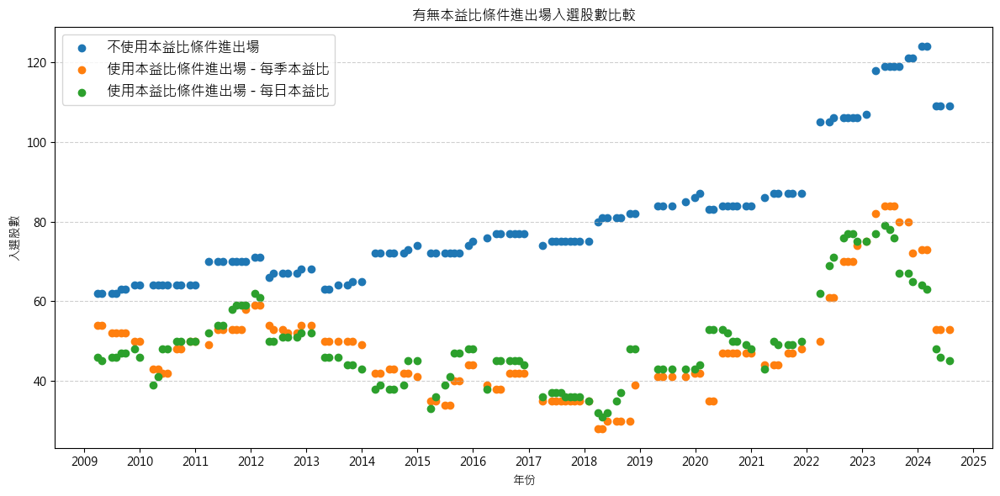

In [71]:
rep_list = [rep_all_cond, rep_all_cond_and_pe, rep_all_cond_and_pe_daily]
label_list = ['不使用本益比條件進出場', '使用本益比條件進出場 - 每季本益比', '使用本益比條件進出場 - 每日本益比']

plot_company_count_comparison(rep_list, label_list, title='有無本益比條件進出場入選股數比較')

---

## **報酬率貢獻度**

In [72]:
def calc_returns_contrib(rep, top_n=None):

    """
    1. 算每個月個別股票`(月底/月初)-1`當每月個股報酬率 
    2. 算每支股票每個月的`個股報酬率/當月總共入選公司數` ← 這要除嗎
    3. 看一整年裡面一支股票入選的月份數當入選次數，把每個月的`個股報酬率/入選股數`加總後，除以入選次數取平均 (X)
        - 個別股票在同一個年度內每個月的報酬率加總
    4. 每年用一個stacked bar plot 呈現
    """

    # 將個股的月報酬率每年加總
    def sum_monthly_returns(rep):
        
        df = rep.cashflow
        stock_columns = [col for col in df.columns if col != 'cash']
        monthly_returns = pd.DataFrame()
        grouped = df.groupby(pd.Grouper(freq='M'))

        # 算每支股票每月的月報酬率
        for name, group in grouped:
            if len(group) > 1:
                month_return = (group[stock_columns].iloc[-1] / group[stock_columns].iloc[0] - 1)
                monthly_returns = pd.concat([monthly_returns, month_return.to_frame(name).T])

        # 除以入選股數
        # 計算每 row 非NaN值的數量
        non_nan_counts = monthly_returns.notna().sum(axis=1)
        # 將每一 row 的所有值除以該 row 當中非NaN的數量 (當月入選股數)
        monthly_returns = monthly_returns.div(non_nan_counts, axis=0)

        # 依照年份把月報酬率加總
        yearly_grouped = monthly_returns.groupby(monthly_returns.index.year)
        annual_average_returns = yearly_grouped.sum()

        return annual_average_returns

    # 每支股票每年的報酬率加總
    annual_average_returns = sum_monthly_returns(rep)


    """
    畫圖

    - 同一張圖上的同一支股票用同一個顏色呈現
    - 報酬率為正，在bar上由大到小排序，從上到下呈現
    - 報酬率為負，在y=0以下呈現，不會包含在 '其他' 類別中
    - 把前N名的股票代號print出來
    """

    # 處理呈現顏色
    all_colors = px.colors.qualitative.Plotly + px.colors.qualitative.Set1 + px.colors.qualitative.Pastel + px.colors.qualitative.Dark2
    color_cycle = cycle(all_colors)
    # 為所有股票ID分配固定顏色
    all_stock_ids = annual_average_returns.columns
    color_dict = {stock_id: next(color_cycle) for stock_id in all_stock_ids}


    fig = go.Figure()


    # print 出來
    top_n_stocks_by_year = {}

    # 對每一年的數據進行排序和處理
    for year in annual_average_returns.index:
        year_data = annual_average_returns.loc[year].sort_values(ascending=False)
        
        # 分離正值和負值
        positive_data = year_data[year_data > 0]
        negative_data = year_data[year_data < 0]

        # 如果設定了top_n，只取前N名的正值
        if top_n is not None:
            top_n_positive = positive_data.nlargest(top_n)
            other_positive = positive_data.drop(top_n_positive.index)

            top_n_stocks_by_year[year] = list(top_n_positive.index)
        else:
            top_n_positive = positive_data
            other_positive = pd.Series()

        # 處理負值（放在y=0以下）
        for column in negative_data.index:
            fig.add_trace(
                go.Bar(
                    x=[year],
                    y=[negative_data[column]],
                    name=column,
                    marker_color=color_dict[column],
                    offsetgroup=column,
                    showlegend=False,
                    hovertemplate=f'%{{x}}<br>%{{y:.2%}}<br>{column}<extra></extra>'
                )
            )

        cumulative_sum = 0

        # 處理'其他'類別的正值
        if not other_positive.empty:
            fig.add_trace(
                go.Bar(
                    x=[year],
                    y=[other_positive.sum()],
                    name=f"其他 ({year})",
                    marker=dict(
                        color='white',
                        pattern_shape="/",
                    ),
                    offsetgroup="其他",
                    showlegend=False,
                    base=cumulative_sum,
                    hovertemplate=f'%{{x}}<br>其他: %{{y:.2%}}<extra></extra>'
                )
            )
            cumulative_sum += other_positive.sum()

        # 處理top_n的正值（由大到小從上到下排序）
        for column in top_n_positive.index[::-1]:  # 反轉順序
            original_return = top_n_positive[column]
            fig.add_trace(
                go.Bar(
                    x=[year],
                    y=[original_return],
                    name=column,
                    marker_color=color_dict[column],
                    offsetgroup=column,
                    base=cumulative_sum,  # 設置基準線
                    hovertemplate=f'{column}: {original_return:.2%}<extra></extra>'
                )
            )
            cumulative_sum += original_return  # 累加值

    # 添加 y=0 的橫線
    fig.add_shape(
        type="line",
        x0=0,
        y0=0,
        x1=1,
        y1=0,
        xref="paper",
        yref="y",
        line=dict(color="black", width=1.5)
    )

    # 標題、label
    fig.update_layout(
        title="個別股票每年報酬率獲利貢獻度",
        xaxis_title="年份",
        yaxis_title="每年報酬率加總",
        barmode='relative',  # 使用相對模式以保持負值在 y=0 以下
        legend_title="股票代號"
    )

    # print list
    print(f"\n前 {top_n} 名股票代號：")
    for year, top_stocks in top_n_stocks_by_year.items():
        print(f"{year}: {', '.join(top_stocks)}")
    
    return fig

In [73]:
# analyze_and_plot_stock_returns(rep_collection_comb.reports['只看 ROE 五年平均 > 15%'])

In [74]:
calc_returns_contrib(rep_all_cond, 5)


前 5 名股票代號：
2009: 2360, 3083, 2374, 6188, 2439
2010: 2498, 1565, 2912, 2103, 5903
2011: 2207, 2450, 1227, 3293, 6277
2012: 1707, 2207, 5534, 3041, 3035
2013: 1476, 6206, 3691, 1707, 1477
2014: 8044, 2383, 9910, 3022, 2207
2015: 9910, 3450, 1707, 6230, 2404
2016: 2103, 2383, 1527, 2450, 3450
2017: 8341, 4919, 1773, 3152, 1808
2018: 4137, 9910, 1477, 5903, 2912
2019: 2207, 3293, 6230, 2404, 9938
2020: 2108, 5269, 8070, 6582, 3293
2021: 8454, 5274, 9941, 5234, 6411
2022: 6245, 2707, 1808, 3443, 4105
2023: 3078, 2382, 3443, 2059, 3131
2024: 3131, 5508, 3030, 6664, 3653


---

---

## 2020、2021股票便宜，但入選股數反而少的問題

In [75]:
daily_pe_M = daily_pe.resample('M').last()

> 本益比 < 12 買入

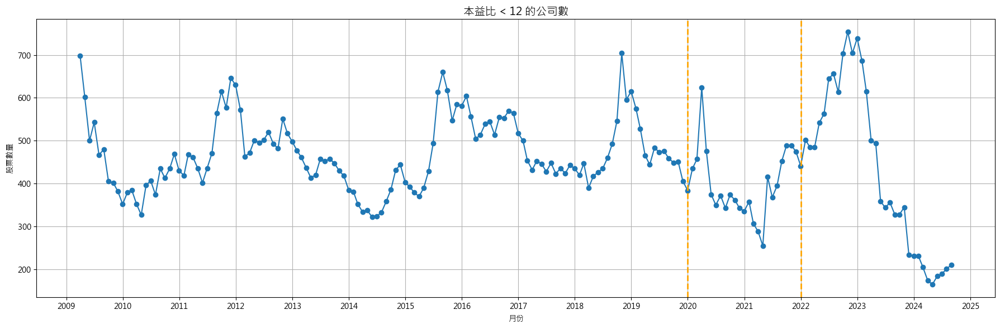

In [76]:
low_pe_counts = (daily_pe_M['2009-03-31':] < 12).sum(axis=1)

plt.figure(figsize=(18, 6))
plt.plot(low_pe_counts.index, low_pe_counts.values, marker='o')
plt.title('本益比 < 12 的公司數', fontsize=14)
plt.xlabel('月份')
plt.ylabel('股票數量')
plt.grid(True)

plt.gca().xaxis.set_major_locator(mdates.YearLocator())
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y'))

# 標記出 2020、2022之間
plt.axvline(pd.to_datetime('2020-01-01'), color='orange', linestyle='--', linewidth=2)
plt.axvline(pd.to_datetime('2022-01-01'), color='orange', linestyle='--', linewidth=2)


# plt.xticks(rotation=90)
plt.tight_layout()

plt.show()

---

## 看入選股數比較少的時候震盪會不會比較大

In [77]:
rep_all_cond_MDD = rep_all_cond.calc_dd(rep_all_cond.stock_data['portfolio_returns'])*100
rep_all_cond_and_pe_MDD = rep_all_cond_and_pe_daily.calc_dd(rep_all_cond_and_pe_daily.stock_data['portfolio_returns'])*100

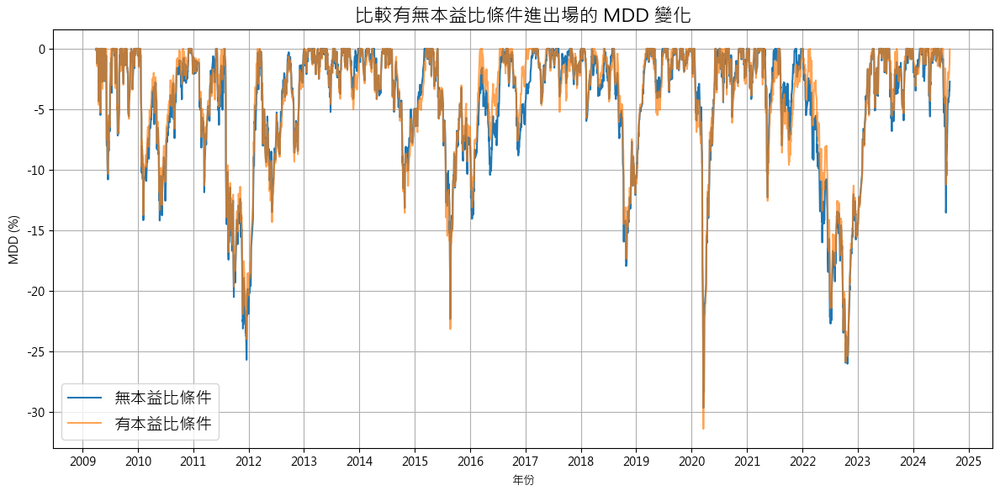

In [78]:
plt.figure(figsize=(12, 6))

plt.plot(rep_all_cond_MDD.index, rep_all_cond_MDD.values, label='無本益比條件')
plt.plot(rep_all_cond_and_pe_MDD.index, rep_all_cond_and_pe_MDD.values, label='有本益比條件', alpha=0.7)

plt.title('比較有無本益比條件進出場的 MDD 變化', fontsize=16)
plt.xlabel('年份')
plt.ylabel('MDD (%)')

plt.legend(fontsize=14)
plt.grid()

plt.gca().xaxis.set_major_locator(mdates.YearLocator())
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y'))

# plt.xticks(rotation=90)

plt.tight_layout()
plt.show()

---

# 比較舊的

## Overall (2005~)

In [79]:
pe_cond_entry_all_daily = daily_pe['2005-03-31':] < 12
pe_cond_exit_all_daily = daily_pe['2005-03-31':] > 30

In [80]:
orig_all_cond_2005 = (roe_15 & rr_cond & payout_ratio_cond & profit_cond & hold_cond & listed)['2005-03-31':]

orig_all_cond_pe_all = ((orig_all_cond_2005 & pe_cond_entry_all_daily).hold_until((~orig_all_cond_2005) | pe_cond_exit_all_daily))['2005-03-31':]

orig_all_cond_pe_all_rep = backtest.sim(orig_all_cond_pe_all, resample='M', data=data)
orig_all_cond_pe_all_rep.display()

,annualized_rate_of_return,sharpe,max_drawdown,win_ratio
,12.67%,26.28,-53.55%,57.45%


,entry_date,exit_date,entry_sig_date,exit_sig_date,position,period,entry_index,exit_index,return,mae,gmfe,bmfe,mdd,pdays,weight,next_weights
stock_id,,,,,,,,,,,,,,,,
1232,2010-05-03,NaT,2010-04-30,NaT,0.022222,3521.0,2582.0,-1.0,6.792400,-0.037802,6.987364,0.000000,-0.286154,3483.0,0.022222,0.021277
1436,2024-04-01,NaT,2024-03-29,NaT,0.020833,104.0,5999.0,-1.0,0.686745,-0.031251,0.853794,0.000000,-0.234701,94.0,0.022222,0.021277
1537,2013-04-01,NaT,2013-03-29,NaT,0.021277,2795.0,3308.0,-1.0,3.390684,-0.060061,3.396534,0.003003,-0.299662,2770.0,0.022222,0.021277
1580,2024-08-01,NaT,2024-07-31,NaT,0.022222,22.0,6081.0,-1.0,0.034554,-0.053872,0.050505,0.000000,-0.053872,15.0,0.022222,0.021277
2020,2024-04-01,NaT,2024-03-29,NaT,0.020833,104.0,5999.0,-1.0,-0.090497,-0.143754,0.054362,0.054362,-0.187901,30.0,0.022222,0.021277
2373,2018-04-02,NaT,2018-03-31,NaT,0.031250,1565.0,4538.0,-1.0,0.194317,-0.034444,0.343983,0.000000,-0.211970,1535.0,0.022222,0.021277
2377,2019-05-02,NaT,2019-04-30,NaT,0.023256,1302.0,4801.0,-1.0,1.891268,-0.117648,2.121388,0.003529,-0.457523,1256.0,0.022222,0.021277
2385,2008-04-01,NaT,2008-03-31,NaT,0.018182,4042.0,2061.0,-1.0,9.998613,-0.427265,15.853607,0.264195,-0.546957,3918.0,0.022222,0.021277
2420,2022-04-01,NaT,2022-03-31,NaT,0.016129,589.0,5514.0,-1.0,0.867862,-0.078794,0.921245,0.011589,-0.214186,424.0,0.022222,0.021277


## 有無本益比進出場 + ROE 參數最佳化

In [81]:
roe_value_cond = {}
# no_roe_conds = rr_cond & payout_ratio_cond & profit_cond & hold_cond & listed

for i in range(10, 26, 5): # 大於 10~25%
    for n in range(3, 6): # 3, 4, 5年平均
        
        roe_rolling = roe.rolling(n).mean()['2005-03-31':]
        roe_cond = roe_rolling > i

        all_conds = roe_cond & rr_cond & payout_ratio_cond & profit_cond & hold_cond & listed

        roe_value_cond[f'roe_{n}y_{i}'] = all_conds['2009-03-31':]
        roe_value_cond[f'roe_{n}y_{i}_pe'] = ((all_conds & daily_pe_cond_entry).hold_until((~all_conds) | daily_pe_cond_exit))['2009-03-31':]
        
collection = sim_conditions(roe_value_cond, resample='M', data=data)
collection.plot_creturns()

Backtesting progress: 100%|██████████| 24/24 [00:21<00:00,  1.10condition/s]


In [82]:
collection.plot_stats(mode='heatmap')

,CAGR,daily_sharpe,max_drawdown,avg_drawdown,win_ratio,ytd
roe_4y_10_pe,0.153394,29.550000,-0.300809,-0.039241,0.605985,0.168179
roe_4y_15_pe,0.153253,30.260000,-0.316323,-0.041486,0.626415,0.190083
roe_5y_10_pe,0.153121,29.620000,-0.303245,-0.039036,0.605000,0.169171
roe_3y_10_pe,0.152750,29.940000,-0.304214,-0.039428,0.617073,0.169499
roe_5y_15_pe,0.146924,31.900000,-0.313765,-0.042163,0.623616,0.184606
roe_3y_15_pe,0.143301,33.910000,-0.314688,-0.044957,0.585714,0.194074
roe_3y_10,0.137807,33.840000,-0.291356,-0.041381,0.557110,0.143894
roe_4y_10,0.137544,33.700000,-0.288755,-0.041440,0.537897,0.148334
roe_4y_15,0.136706,34.080000,-0.294046,-0.043653,0.579861,0.142193
roe_5y_10,0.136334,34.130000,-0.290575,-0.041847,0.529268,0.151447


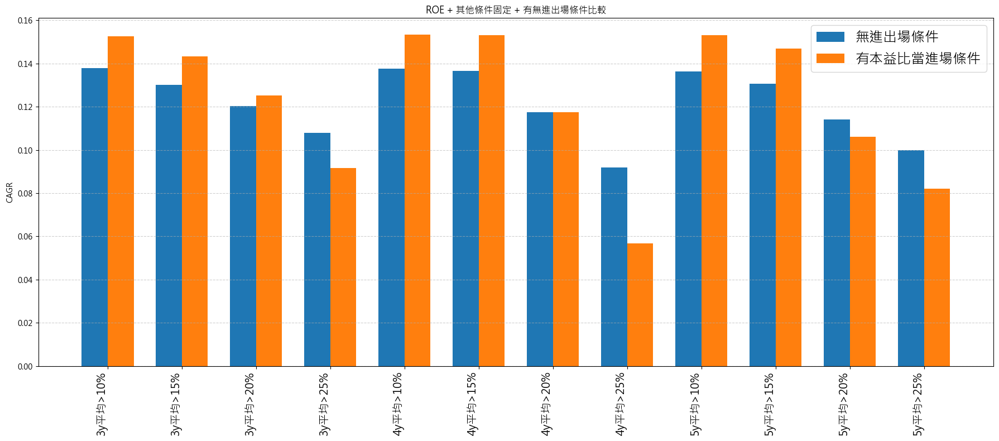

In [83]:
plot_roe_cagr_w_pe(collection)

---

In [88]:
roe_value_cond = {}

for i in range(10, 26, 5): # 大於 10~25%
    for n in range(3, 6): # 3, 4, 5年平均
        
        roe_rolling = roe.rolling(n).mean()['2009-03-31':]
        roe_cond = roe_rolling > i
        roe_value_cond[f'roe_{n}y_{i}'] = roe_cond & rr_cond & payout_ratio_cond & profit_cond & hold_cond & listed

        
roe_value_collc = sim_conditions(roe_value_cond, resample='M', data=data)
roe_value_collc.plot_creturns()

Backtesting progress: 100%|██████████| 12/12 [00:12<00:00,  1.06s/condition]


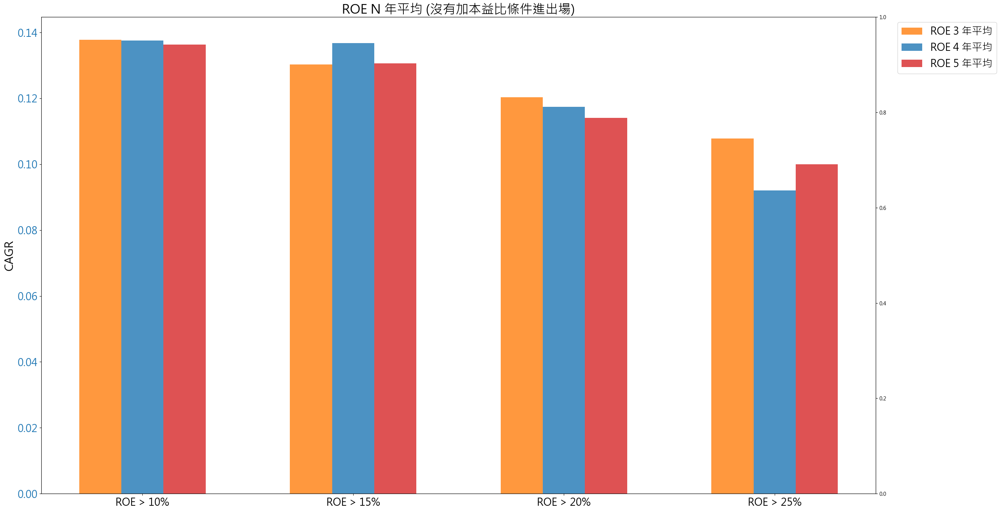

In [89]:
plot_roe_cagr(roe_value_collc, plot_line_chart=False, title="ROE N 年平均 (沒有加本益比條件進出場)")

In [90]:
roe_value_cond_pe = {}

for i in range(10, 26, 5): # 大於 10~25%
    for n in range(3, 6): # 3, 4, 5年平均
        
        roe_rolling = roe.rolling(n).mean()['2005-03-31':]
        roe_cond = roe_rolling > i

        roe_test_all_conds = (roe_cond & rr_cond & payout_ratio_cond & profit_cond & hold_cond & listed)['2009-03-31':]

        roe_value_cond_pe[f'roe_{n}y_{i}'] = (roe_test_all_conds & daily_pe_cond_entry).hold_until((~roe_test_all_conds) | daily_pe_cond_exit)
        
roe_value_collc_pe = sim_conditions(roe_value_cond_pe, resample='M', data=data)
roe_value_collc_pe.plot_creturns()

Backtesting progress: 100%|██████████| 12/12 [00:08<00:00,  1.35condition/s]


In [91]:
roe_value_collc_pe.plot_stats(mode='heatmap')

,CAGR,daily_sharpe,max_drawdown,avg_drawdown,win_ratio,ytd
roe_4y_10,0.153394,29.550000,-0.300809,-0.039241,0.605985,0.168179
roe_4y_15,0.153253,30.260000,-0.316323,-0.041486,0.626415,0.190083
roe_5y_10,0.153121,29.620000,-0.303245,-0.039036,0.605000,0.169171
roe_3y_10,0.152750,29.940000,-0.304214,-0.039428,0.617073,0.169499
roe_5y_15,0.146924,31.900000,-0.313765,-0.042163,0.623616,0.184606
roe_3y_15,0.143301,33.910000,-0.314688,-0.044957,0.585714,0.194074
roe_3y_20,0.125323,41.820000,-0.319149,-0.054428,0.586826,0.240059
roe_4y_20,0.117569,44.290000,-0.320142,-0.054546,0.608974,0.196746
roe_5y_20,0.106113,46.960000,-0.320142,-0.057838,0.611111,0.125942
roe_3y_25,0.091541,62.580000,-0.377298,-0.098245,0.553191,0.203094


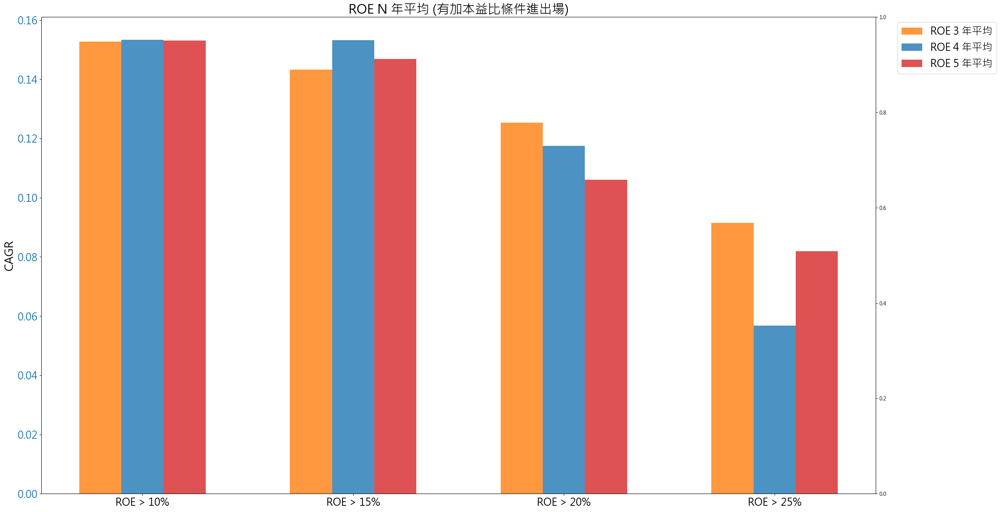

In [92]:
plot_roe_cagr(roe_value_collc_pe, plot_line_chart=False, title="ROE N 年平均 (有加本益比條件進出場)")